In [52]:
library(foreach)

source("source_local.R")

In [6]:
options(repr.plot.width=15, repr.plot.height=6)

In [7]:
cl <- parallel::makeCluster(4)
doSNOW::registerDoSNOW(cl)
cl

socket cluster with 4 nodes on host ‘localhost’

# Setup

## Code

In [23]:
setUpDataRoot <- function() {
    dir.create(DATA_ROOT)
    dir.create(file.path(DATA_ROOT, "simulations"))
    dir.create(file.path(DATA_ROOT, "experiments"))
}

In [24]:
getSimulationFilename <- function(ntypes, rep, noise) {
    file.path(DATA_ROOT, "simulations", paste0(ntypes, "_", rep, "_", noise, ".rds"))
}

saveSimulation <- function(simulation, ntypes, rep, noise) {
    filename <- getSimulationFilename(ntypes, rep, noise)
    saveRDS(simulation, filename)
}

loadSimulation <- function(ntypes, rep, noise) {
    filename <- getSimulationFilename(ntypes, rep, noise)
    readRDS(filename)
}

simulationExists <- function(ntypes, rep, noise) {
    filename <- getSimulationFilename(ntypes, rep, noise)
    file.exists(filename)
}

In [25]:
getExperimentFilename <- function(ntypes, rep, noise, model_name) {
    file.path(DATA_ROOT, "experiments", paste0(ntypes, "_", rep, "_", noise, "_", model_name, ".rds"))
}

saveExperiment <- function(experiment, ntypes, rep, noise, model_name) {
    filename <- getExperimentFilename(ntypes, rep, noise, model_name)
    saveRDS(experiment, filename)
}

loadExperiment <- function(ntypes, rep, noise, model_name) {
    filename <- getExperimentFilename(ntypes, rep, noise, model_name)
    readRDS(filename)    
}

experimentExists <- function(ntypes, rep, noise, model_name) {
    filename <- getExperimentFilename(ntypes, rep, noise, model_name)
    file.exists(filename)   
}

In [27]:
getExperimentPredTrueBasis <- function(experiment, simulation) {
    pred_basis <- experiment$signatures    
    true_basis <- simulation$basis[rownames(pred_basis), ]
    pred_basis <- pred_basis[, guessOrder(t(pred_basis), t(true_basis))]
    list(pred = pred_basis, true = true_basis)
}

getExperimentPredTrueProps <- function(experiment, simulation) {
    pred_props <- experiment$proportions
    true_props <- simulation$proportions[, colnames(pred_props)]
    pred_props <- pred_props[guessOrder(pred_props, true_props), ]
    list(pred = pred_props, true = true_props)
}

In [28]:
getExperimentTableFilename <- function() {
    paste0(
        DATA_ROOT, "/",
        paste(ntypes_variants, collapse=","),
        "_", paste(reps, collapse=","),
        "_", paste(noises, collapse=","),
        "_", paste(model_names, collapse=","),
        ".rds"
    )
}

saveExperimentTable <- function(table) {
    saveRDS(table, getExperimentTableFilename())
}

loadExperimentTable <- function() {
    readRDS(getExperimentTableFilename())
}

## Config

In [32]:
ntypes_variants <- c(3)
reps <- c(1, 2, 3)
noises <- c(1, 3.5, 4, 4.5, 5)
model_names <- c("linseed2", "dsa", "deconf", "brunet", "lee")

n_genes = 12000
n_samples = 40

In [33]:
DATA_ROOT = "../data/linseed2_tests"

# Run experiments

In [34]:
setUpDataRoot()

Warning message in dir.create(DATA_ROOT):
“'../data/linseed2_tests' already exists”
Warning message in dir.create(file.path(DATA_ROOT, "simulations")):
“'../data/linseed2_tests/simulations' already exists”
Warning message in dir.create(file.path(DATA_ROOT, "experiments")):
“'../data/linseed2_tests/experiments' already exists”


## Create simulations

In [36]:
for (ntypes in ntypes_variants) {
    message(paste(ntypes, "cell types"))
    for (rep in reps) {
        if (!simulationExists(ntypes, rep, 0)) {
            message(paste("Generating data for replicate", rep))
            simulation <- 
                createSimulation(n_genes = n_genes, n_samples = n_samples, n_cell_types = ntypes) %>%
                    addPureSamples(, samples_per_cell_type = 3) %>%
                    addBasisSamples() %>%
                    addDeMarkerList()
            saveSimulation(simulation, ntypes, rep, 0)
        } else {
            message(paste("Replicate", rep, "base data is already generated"))
        }
        for (noise in noises) {
            if (!simulationExists(ntypes, rep, noise)) {
                sims_with_noise <- list()
                noise_r2s <- list()
                for (i in 1:100) {
                    sim_with_noise <- addNoise(simulation, noise)
                    sims_with_noise[[i]] <- sim_with_noise
                    noise_r2s[[i]] <- r2(
                        sim_with_noise$data[, sim_with_noise$basis_sample_names],
                        sim_with_noise$basis
                    )
                }
                noise_r2s <- unlist(noise_r2s)
                median_noise_idx <- which.min(abs(noise_r2s - median(noise_r2s)))
                sim_with_noise <- sims_with_noise[[median_noise_idx]]
                noise_r2 <- noise_r2s[median_noise_idx]
                message(paste0("Noise: ", sim_with_noise$data_noise_deviation, ", R2: ", noise_r2))
                saveSimulation(sim_with_noise, ntypes, rep, noise)
            } else {
                message(paste("Simulation for noise", noise, "is already generated"))
            }
        }

    }
}

3 cell types

Replicate 1 base data is already generated

Noise: 1, R2: 0.999999999999963

Noise: 3.5, R2: 0.999999998237181

Noise: 4, R2: 0.999999981043234

Noise: 4.5, R2: 0.999999647134673

Simulation for noise 5 is already generated

Replicate 2 base data is already generated

Noise: 1, R2: 0.999999999999963

Noise: 3.5, R2: 0.999999998241283

Noise: 4, R2: 0.999999975531517

Noise: 4.5, R2: 0.999999747672741

Simulation for noise 5 is already generated

Replicate 3 base data is already generated

Noise: 1, R2: 0.999999999999963

Noise: 3.5, R2: 0.999999998445167

Noise: 4, R2: 0.999999977254456

Noise: 4.5, R2: 0.999999765793206

Simulation for noise 5 is already generated



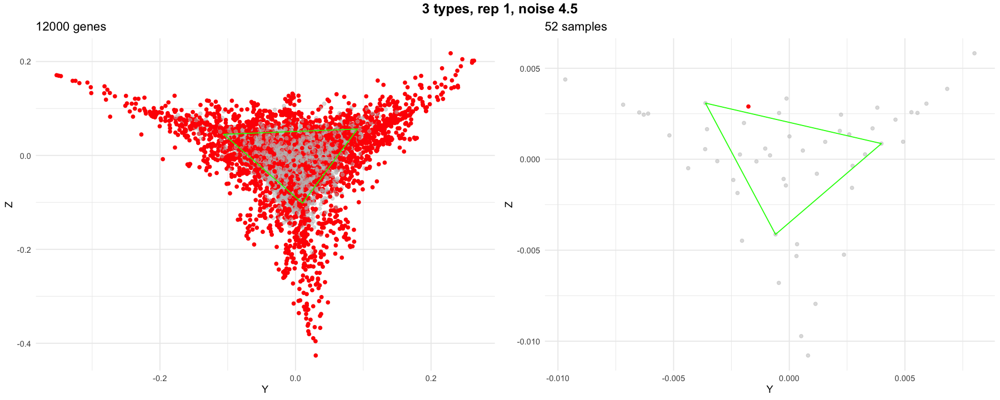

In [73]:
sim_noise_r2s <- data.frame(matrix(ncol=4, nrow=0))
colnames(sim_noise_r2s) <- c("ntypes", "rep", "noise", "noise_r2")
for (ntypes in ntypes_variants) {
    for (rep in c(1)) {
        for (noise in c(4.5)) {
            sim <- loadSimulation(ntypes, rep, noise)
            
            lo2 <- SinkhornNNLSLinseed$new(
                dataset = sim$data,
                path = "../data/linseed2_results",
                analysis_name = "deconv_comparison_2",
                cell_types = ntypes,
            )
            lo2$scaleDataset(iterations = 20)
            lo2$getSvdProjectionsNew(k = ntypes)
            lo2$selectInitRandom(seed = 5)
            plots <- plotPointsColored(lo2, arrange = F)
            show(
                ggpubr::ggarrange(
                    plots[[1]], 
                    plots[[2]],
                    ncol = 2
                ) %>% annotate_figure(
                    top = text_grob(
                        paste0(ntypes, " types, rep ", rep, ", noise ", noise),
                        size = 15,
                        face = "bold"
                    )
                )
            )
            
            noise_r2 <- r2(sim$data[, sim$basis_sample_names], sim$basis)
            sim_noise_r2s[nrow(sim_noise_r2s) + 1,] <- c(ntypes, rep, noise, noise_r2)
        }
    }
}
sim_noise_r2s$ntypes <- as.factor(sim_noise_r2s$ntypes)
sim_noise_r2s$rep <- as.factor(sim_noise_r2s$rep)

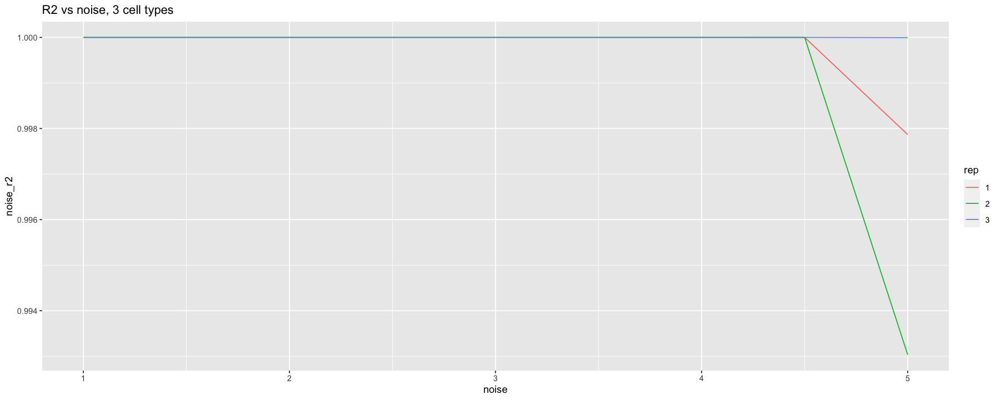

In [38]:
for (ntypes in ntypes_variants) {
    show(
        ggplot(
            sim_noise_r2s[sim_noise_r2s$ntypes == ntypes,],
            aes(x = noise, y = noise_r2, col = rep)
        ) + geom_line() + ggtitle(paste("R2 vs noise,", ntypes, "cell types"))
    )
}

## Fit models

linseed2_tests/experiments/3_1_0_linseed2.rds



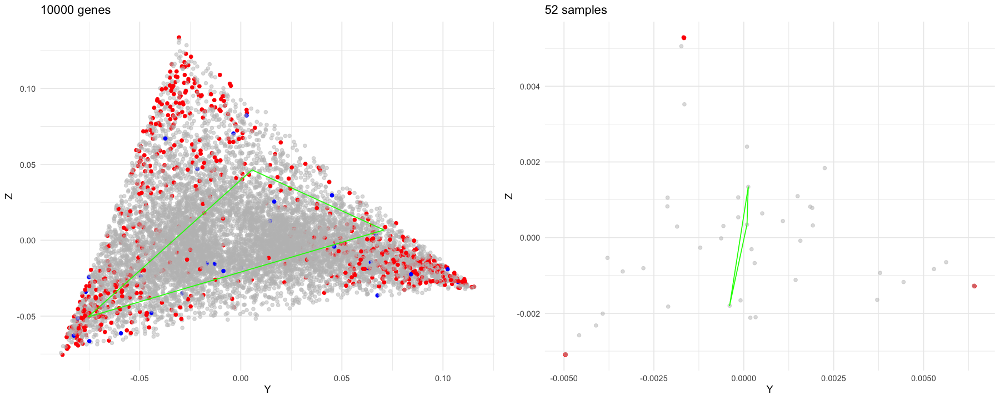

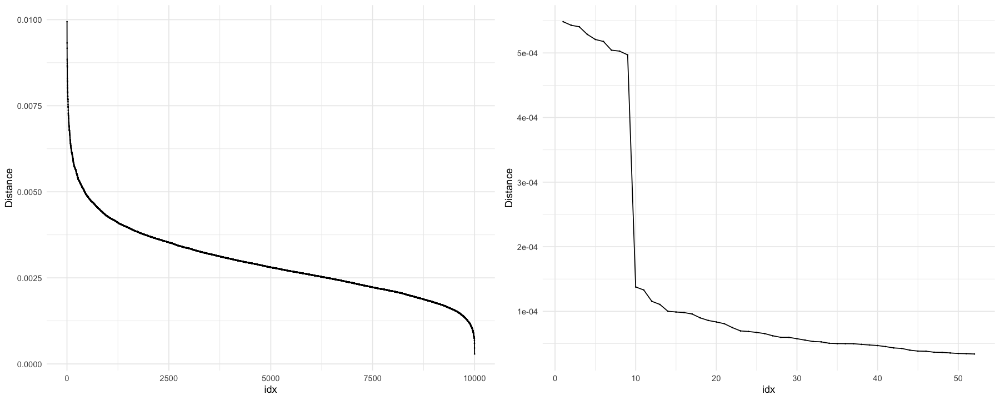

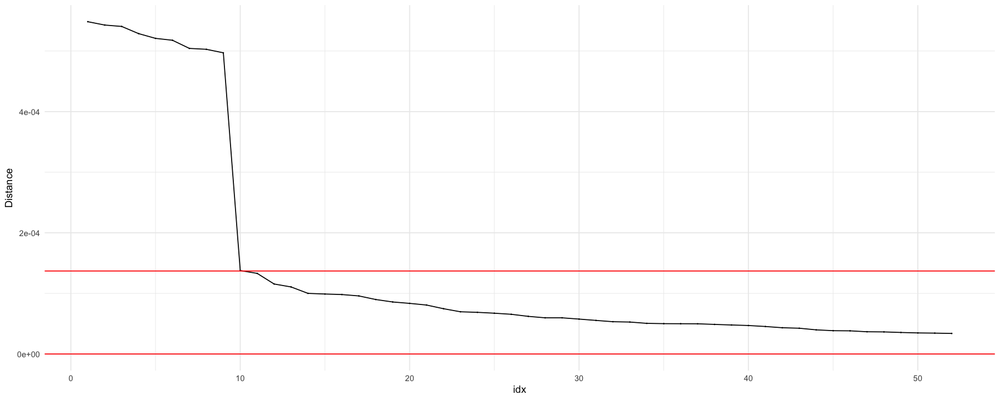

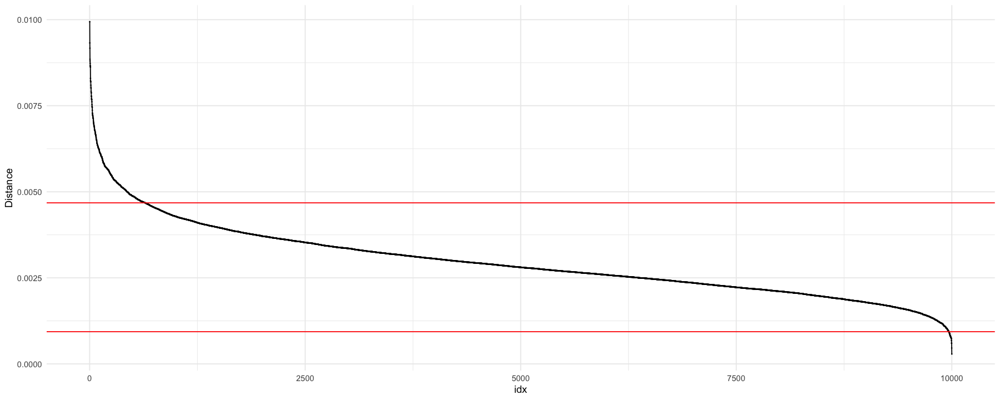

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


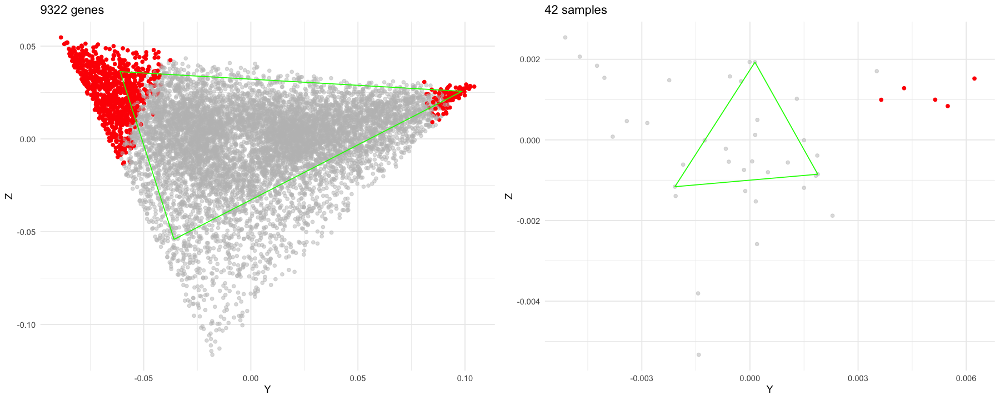

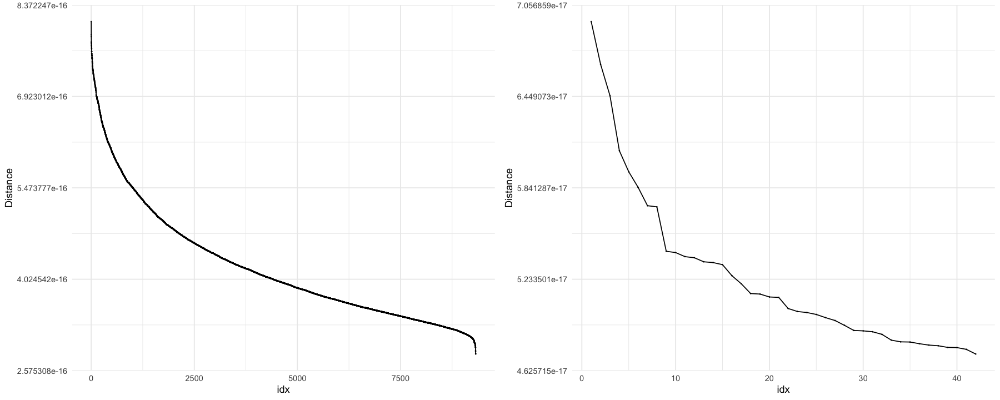

linseed2_tests/experiments/3_1_2_linseed2.rds



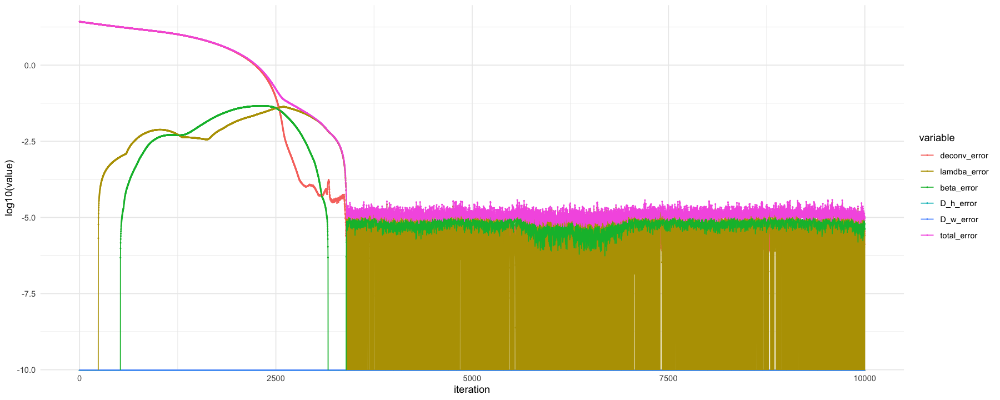

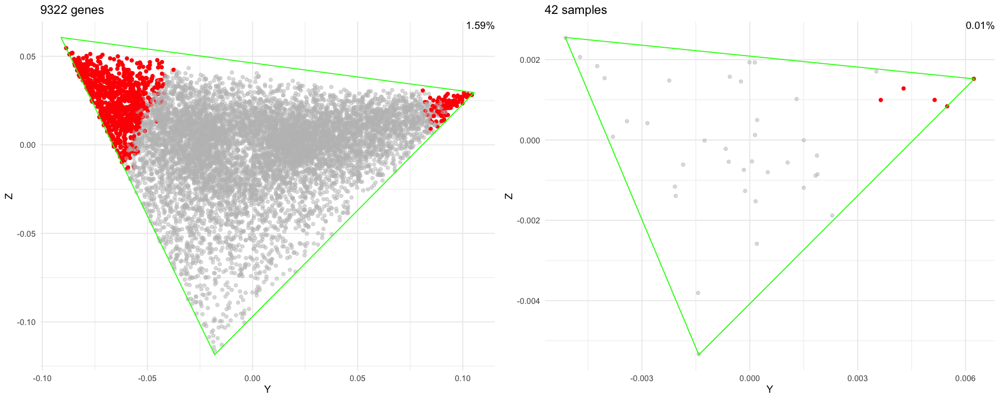

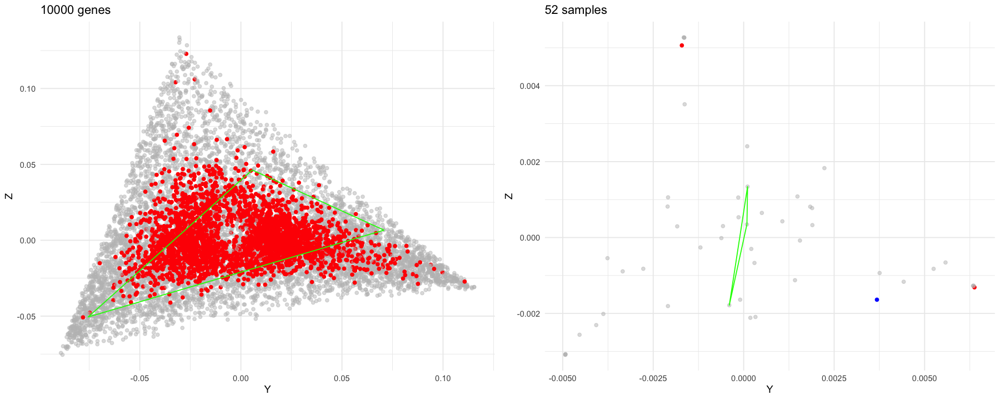

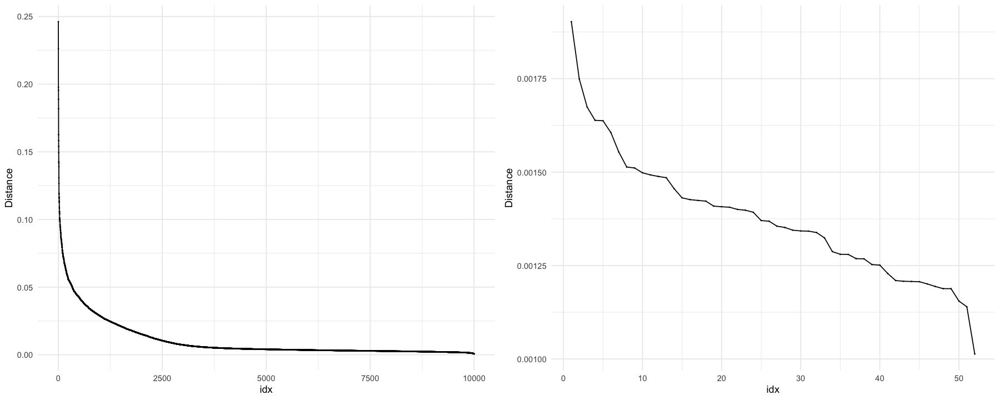

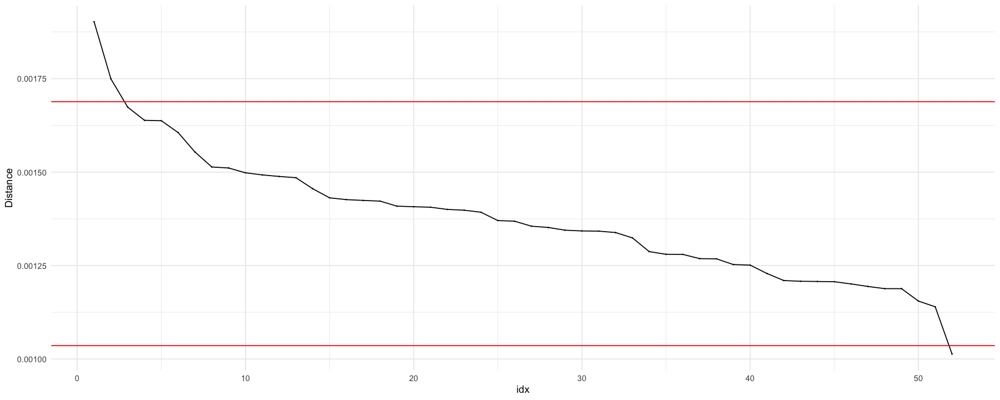

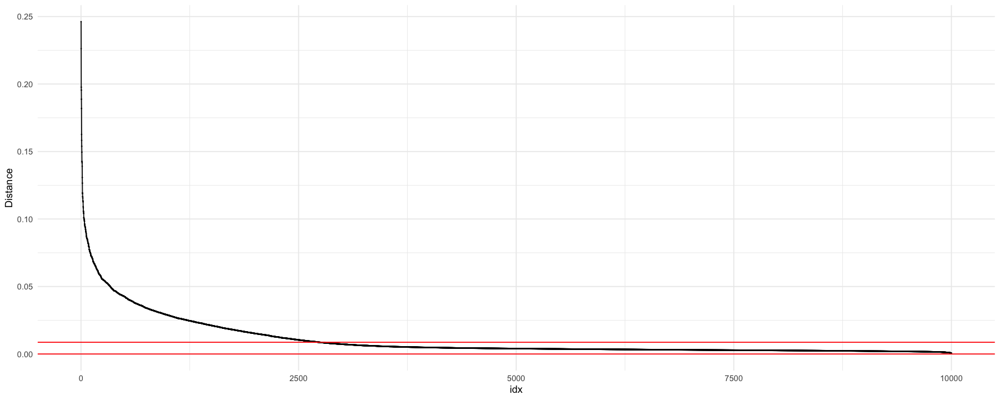

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


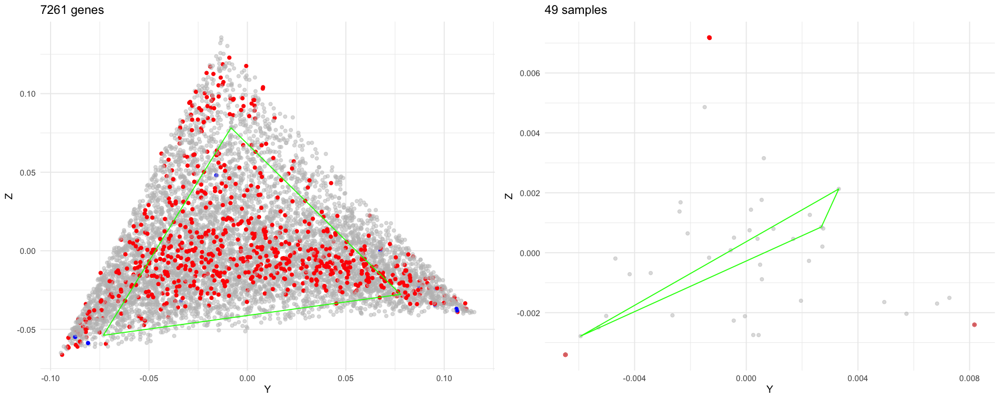

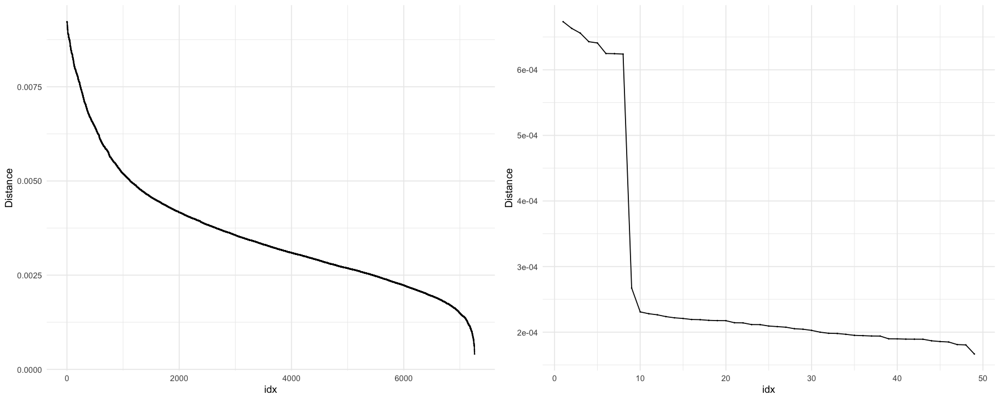

linseed2_tests/experiments/3_1_3_linseed2.rds



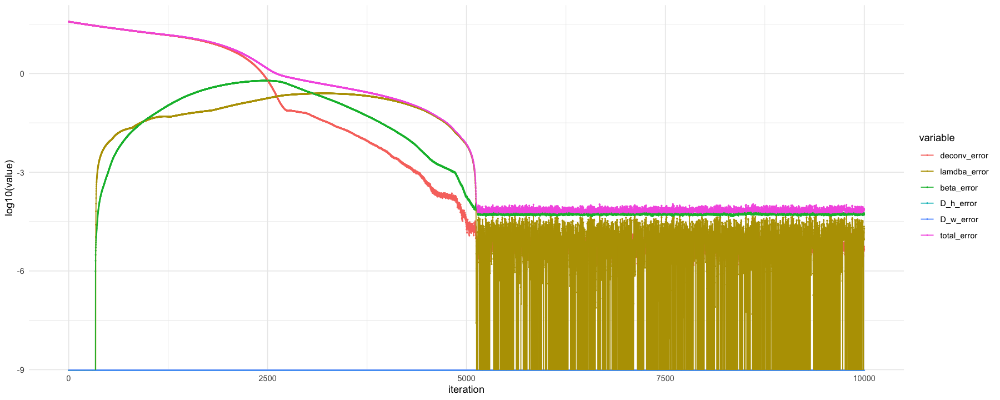

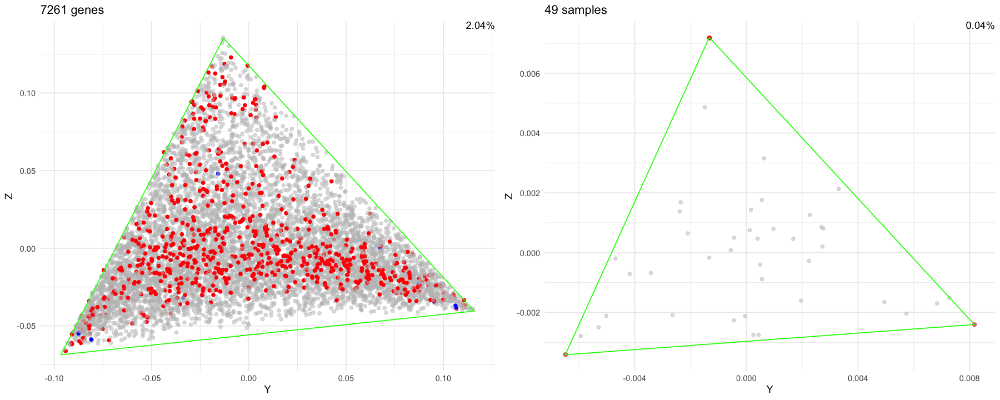

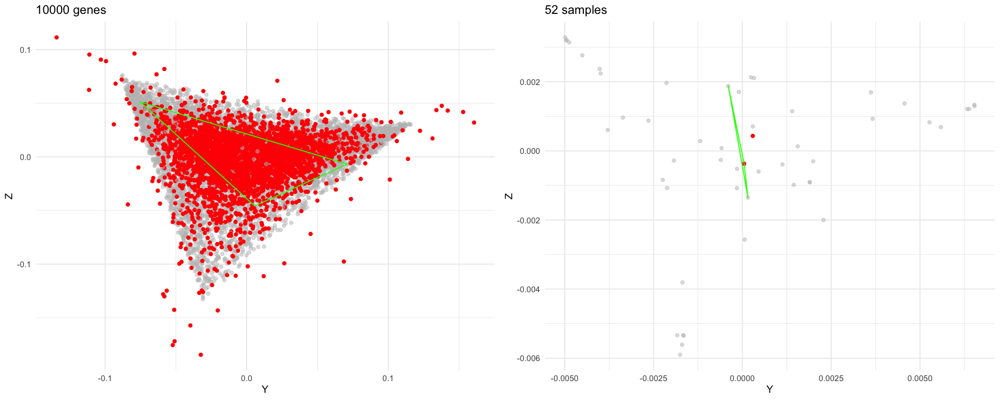

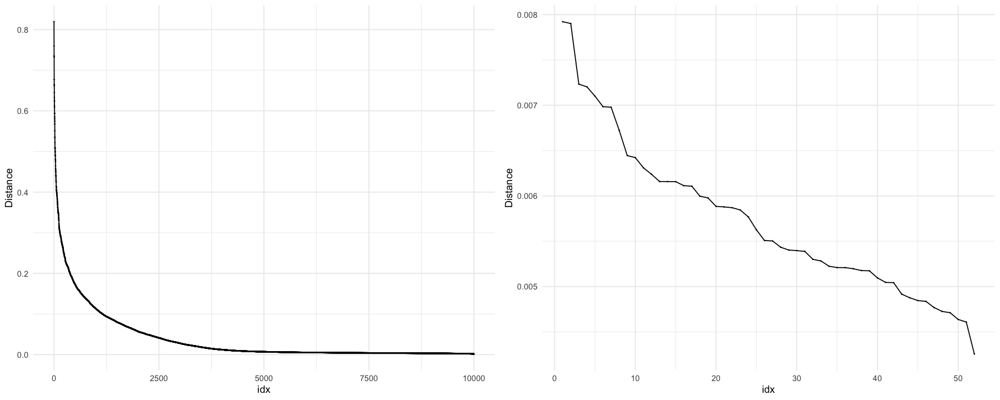

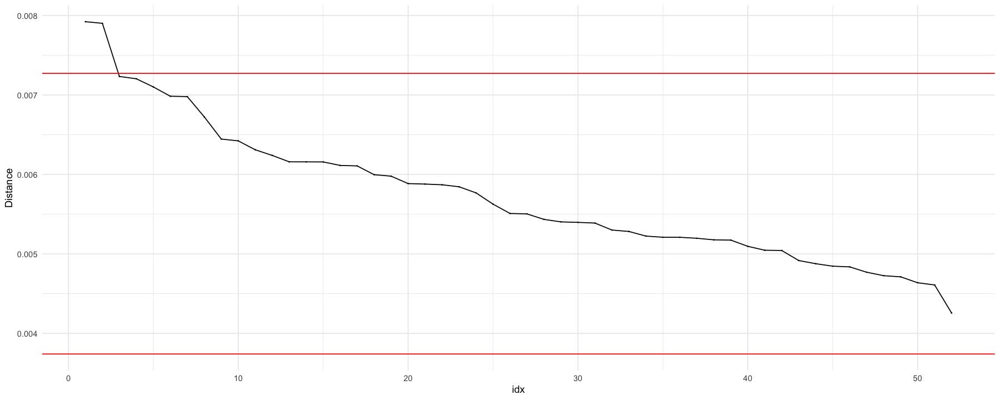

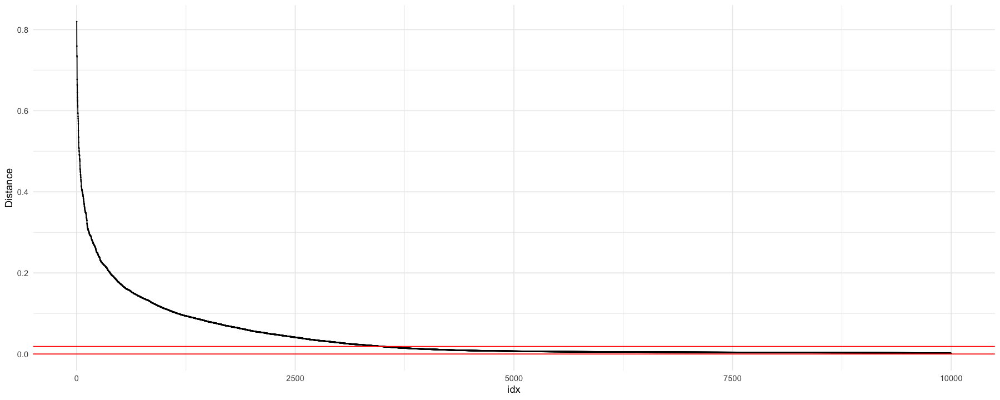

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


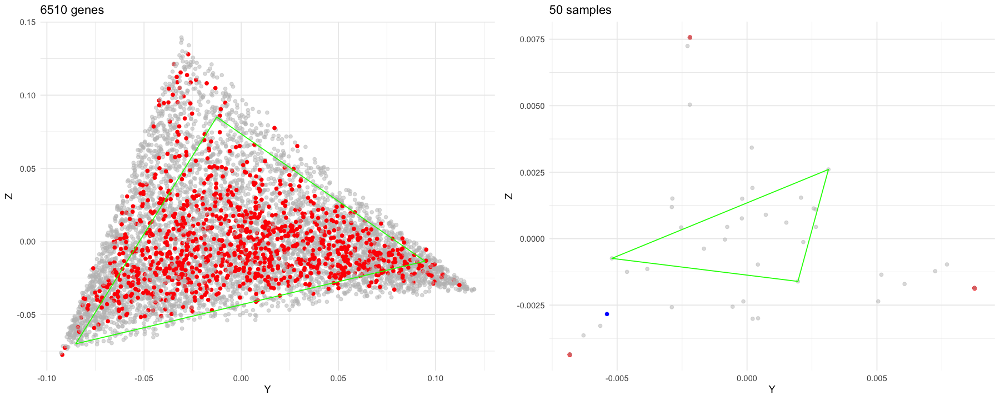

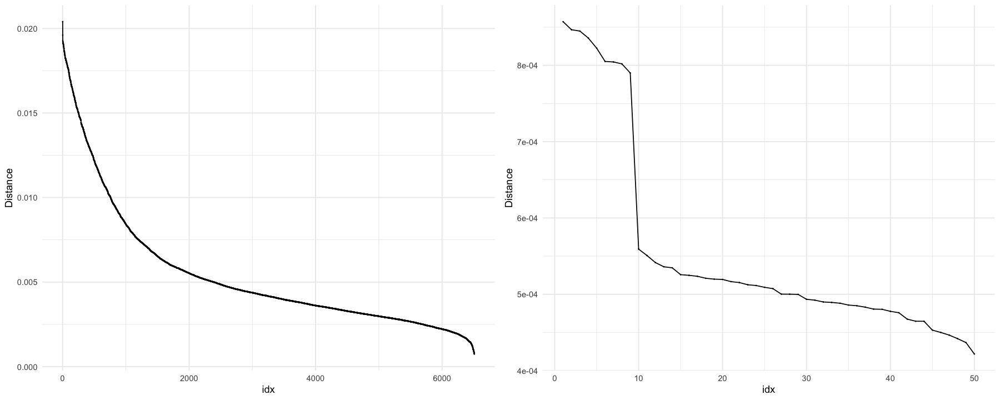

linseed2_tests/experiments/3_1_5_linseed2.rds



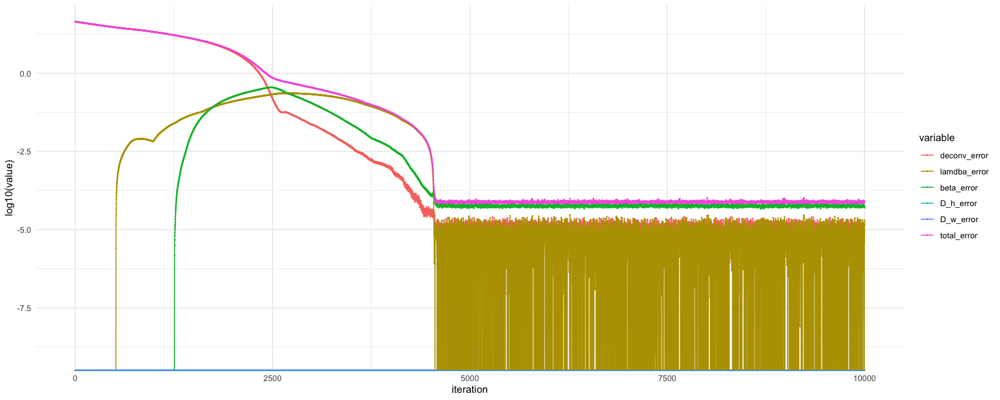

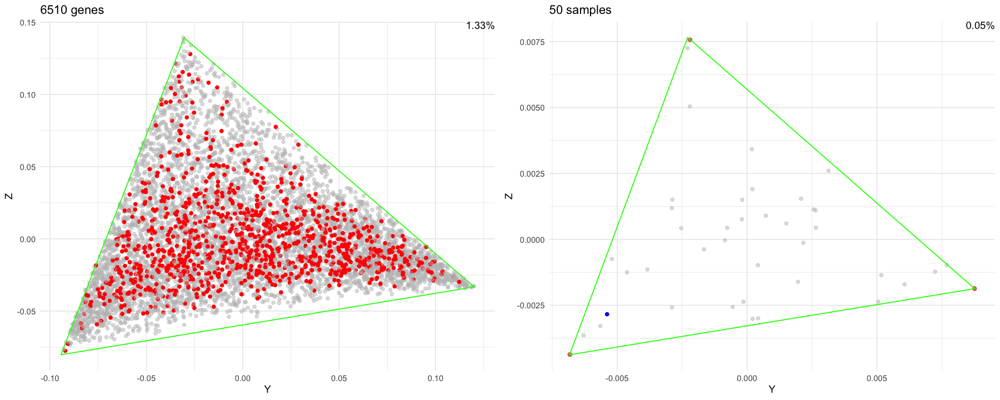

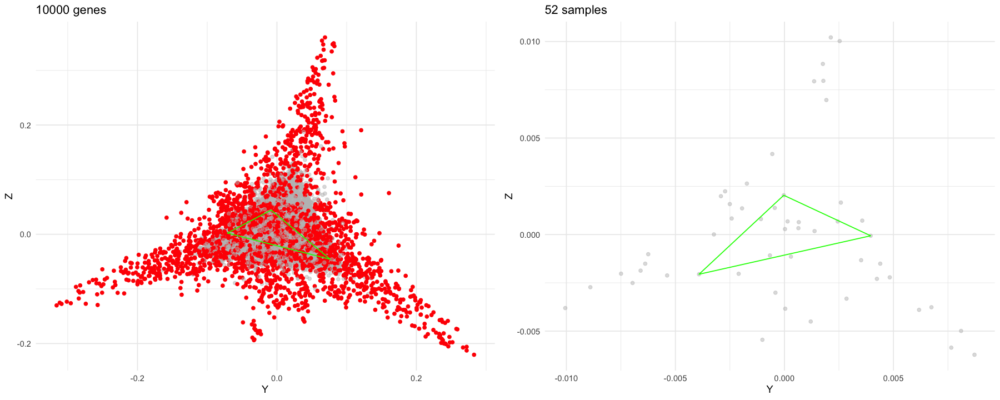

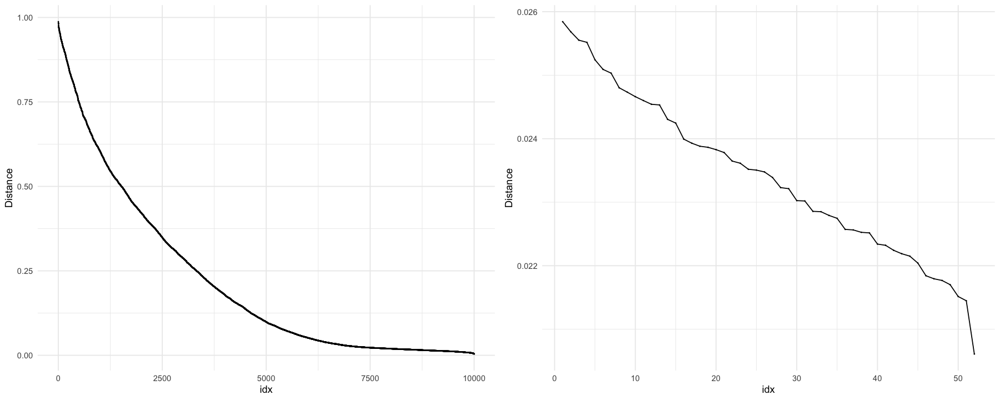

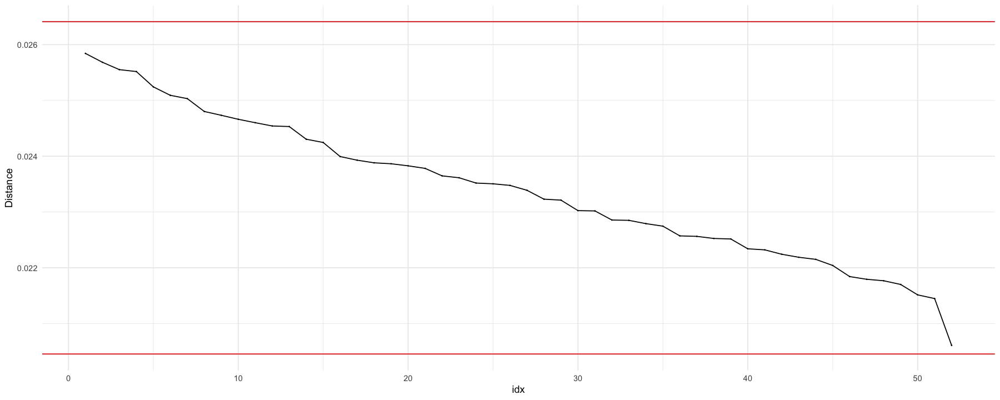

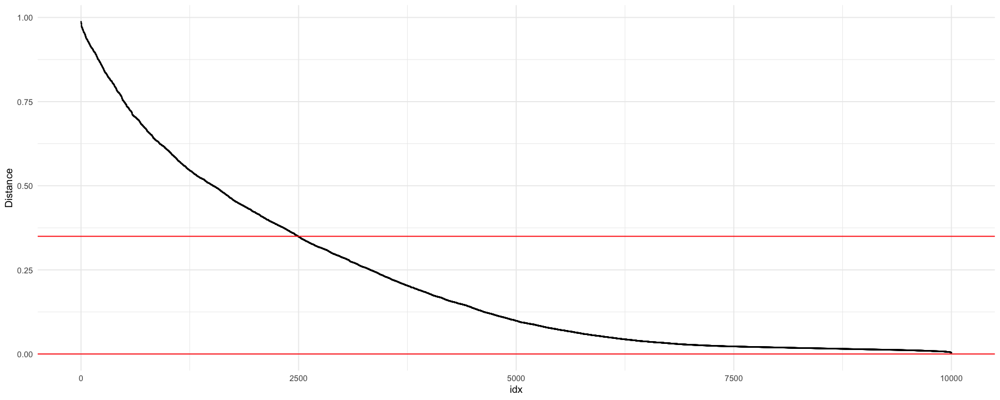

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


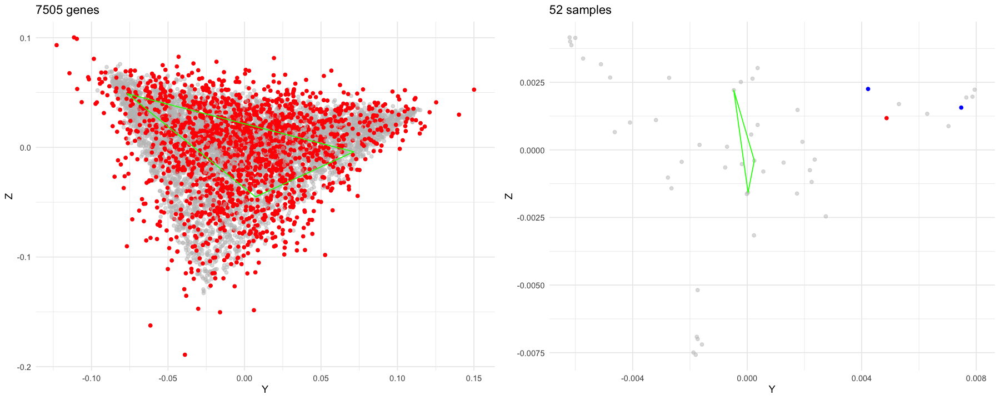

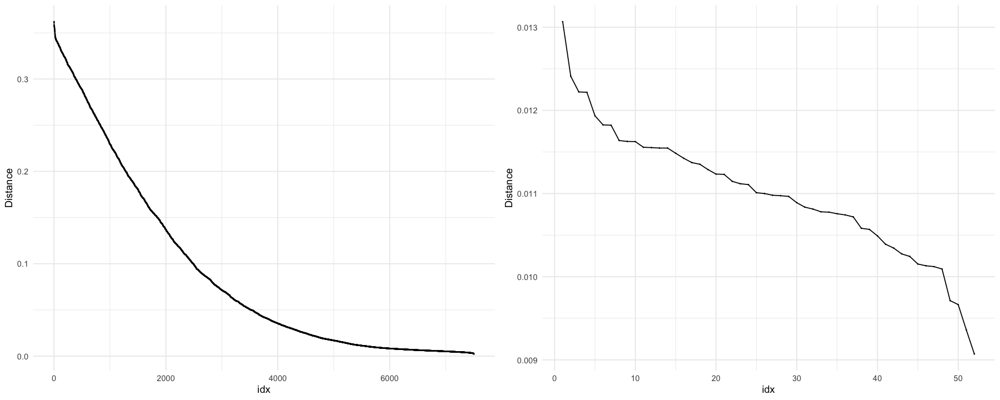

linseed2_tests/experiments/3_2_0_linseed2.rds



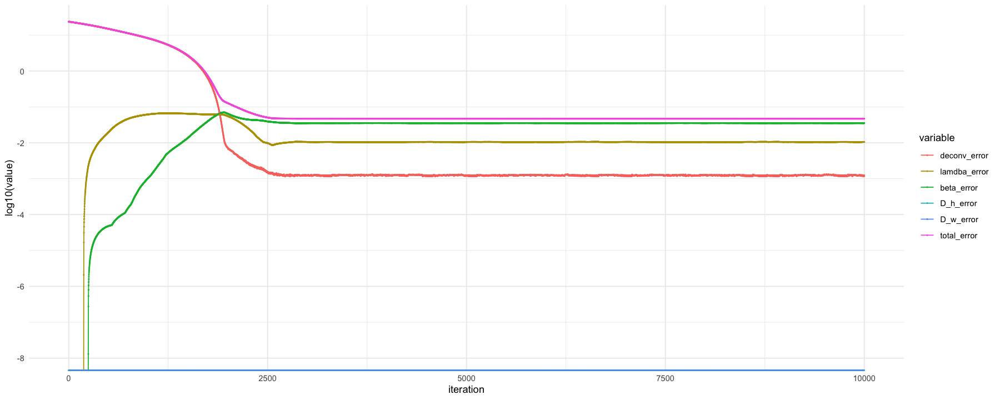

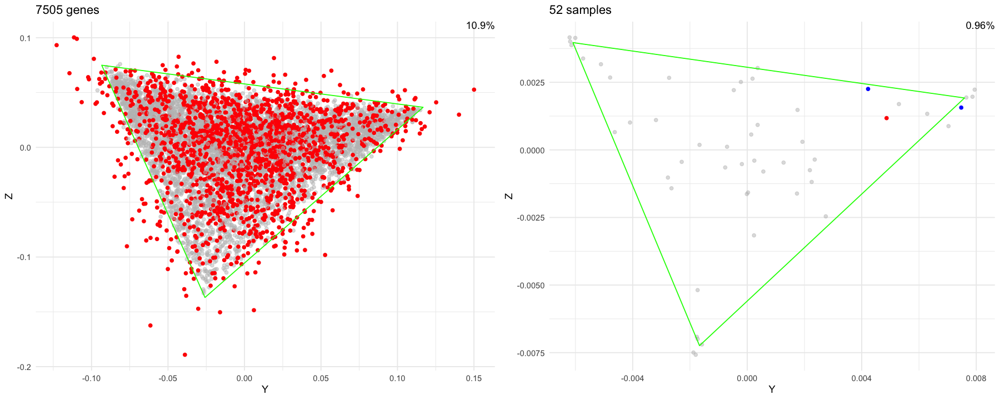

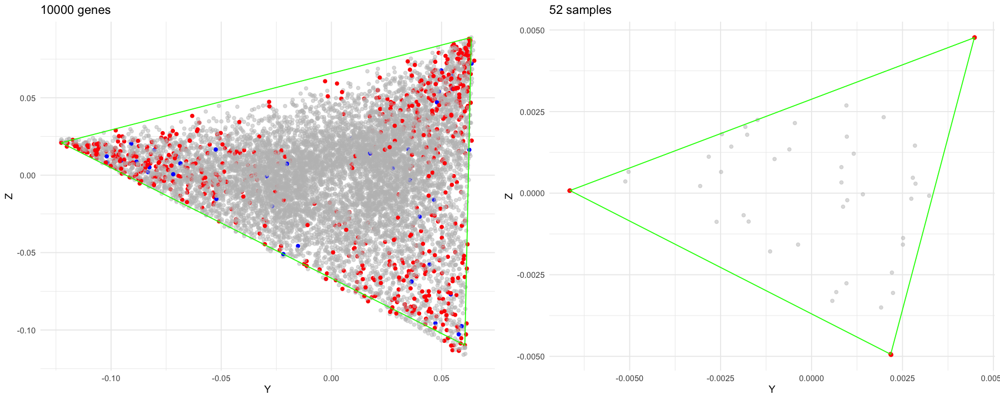

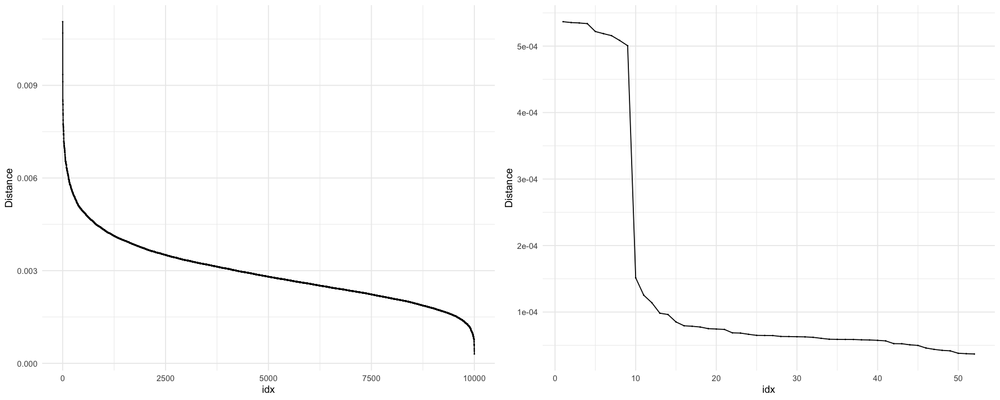

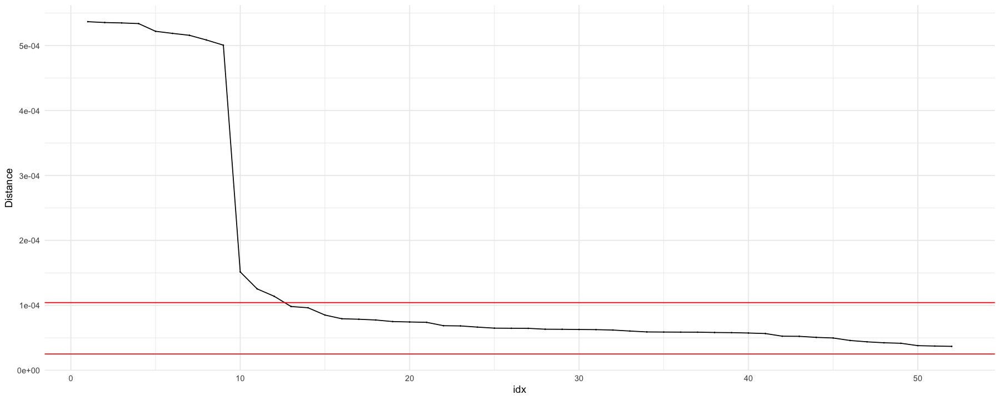

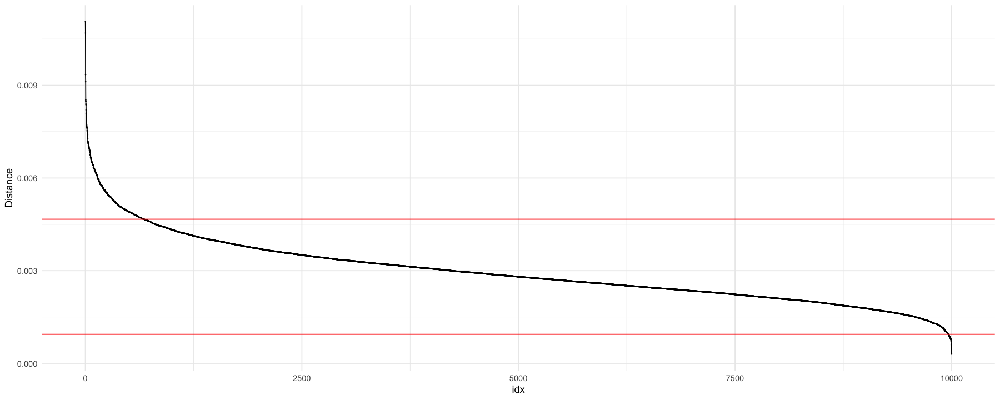

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


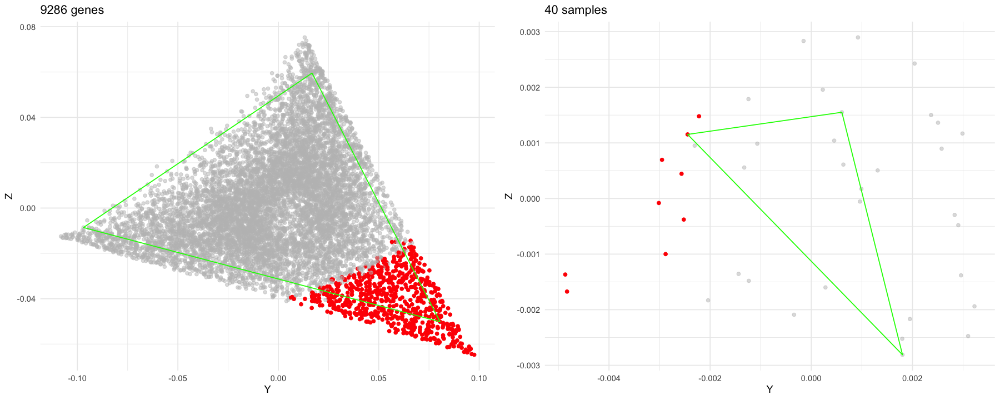

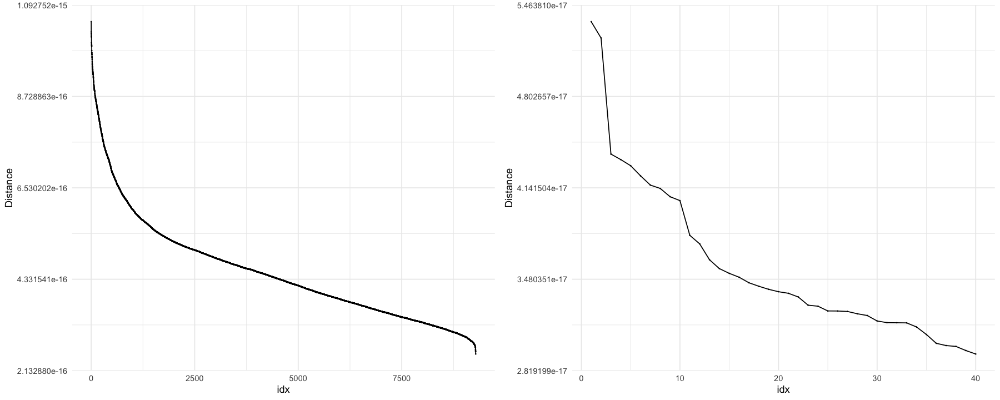

linseed2_tests/experiments/3_2_2_linseed2.rds



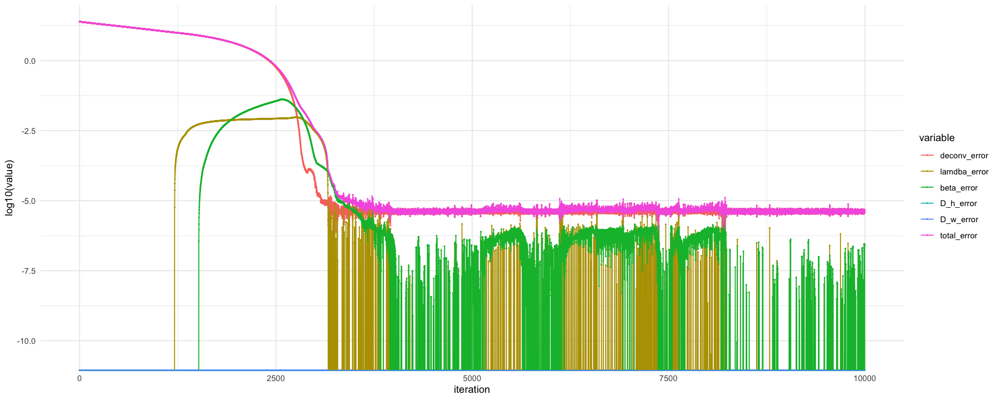

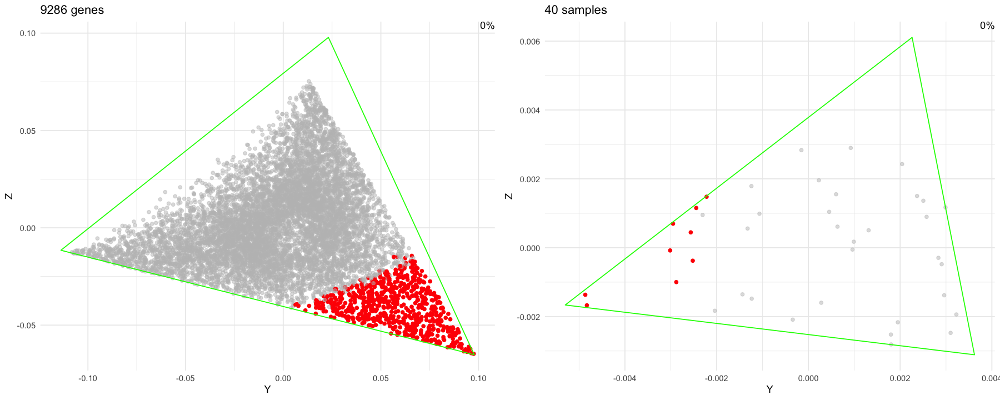

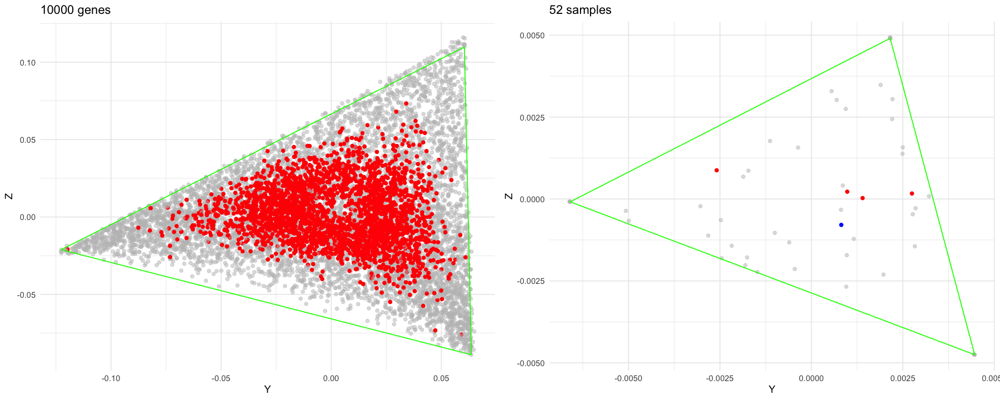

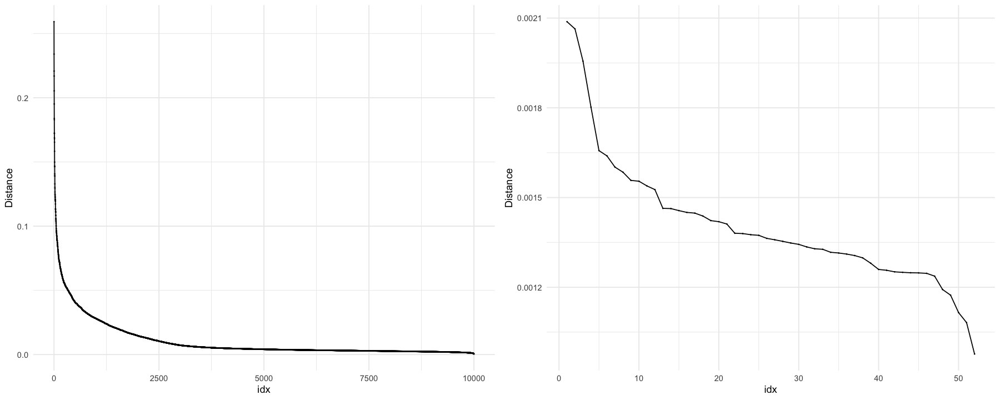

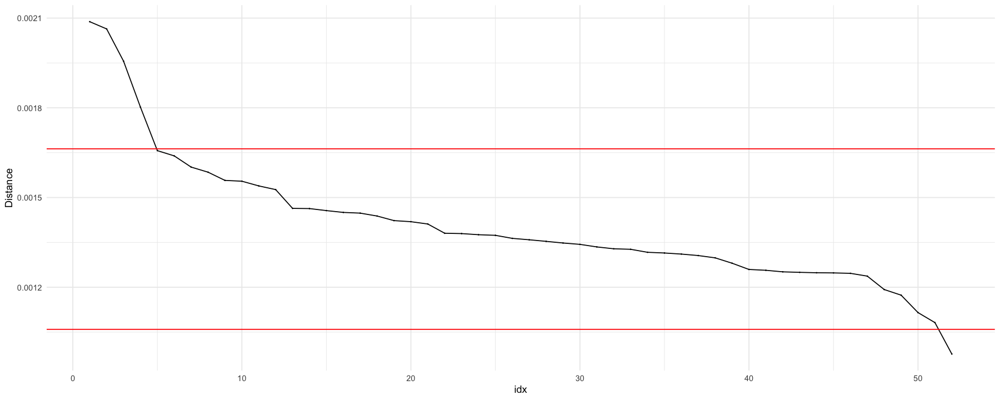

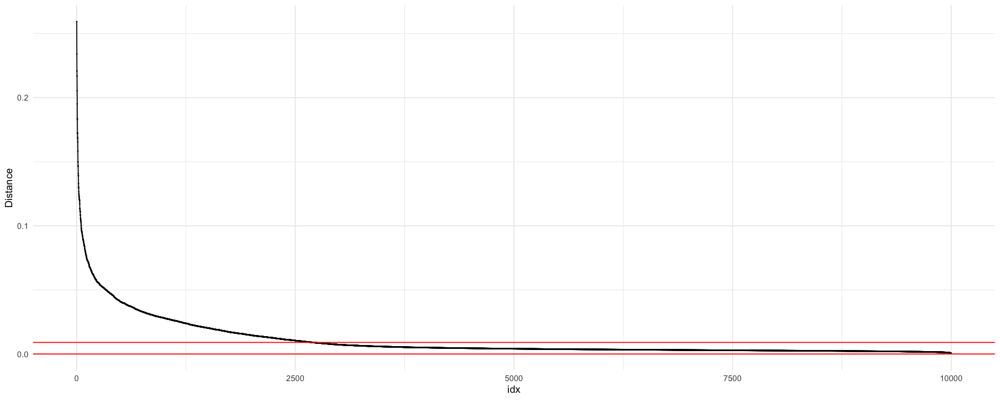

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


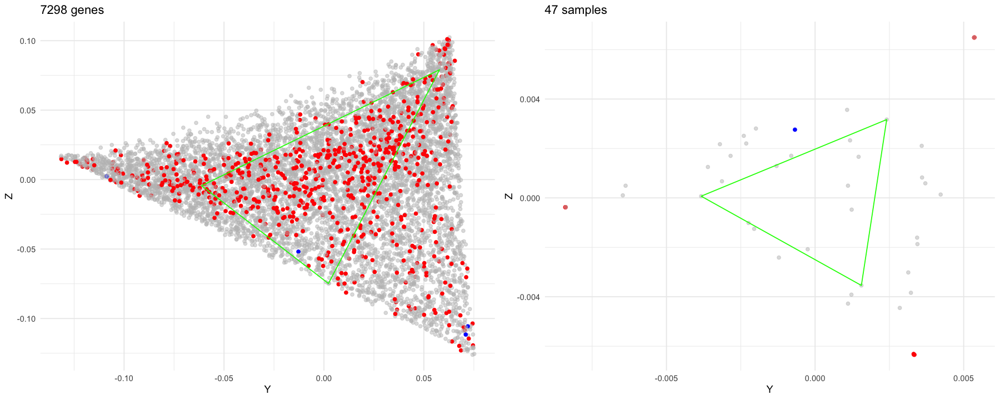

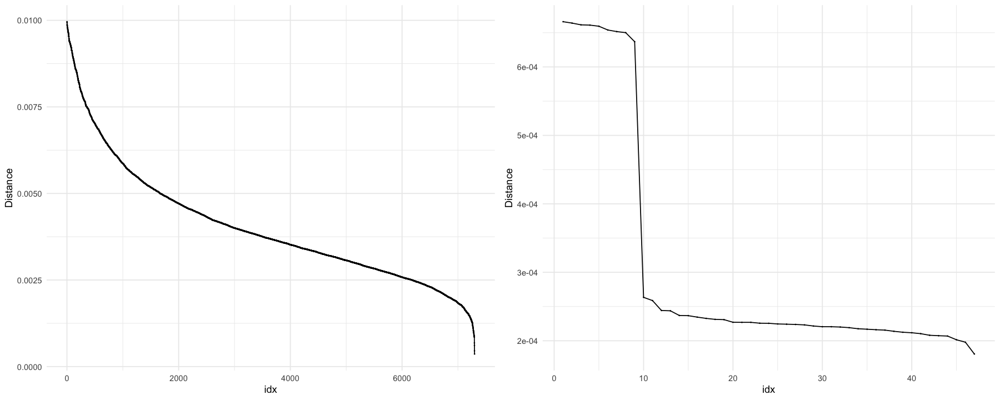

linseed2_tests/experiments/3_2_3_linseed2.rds



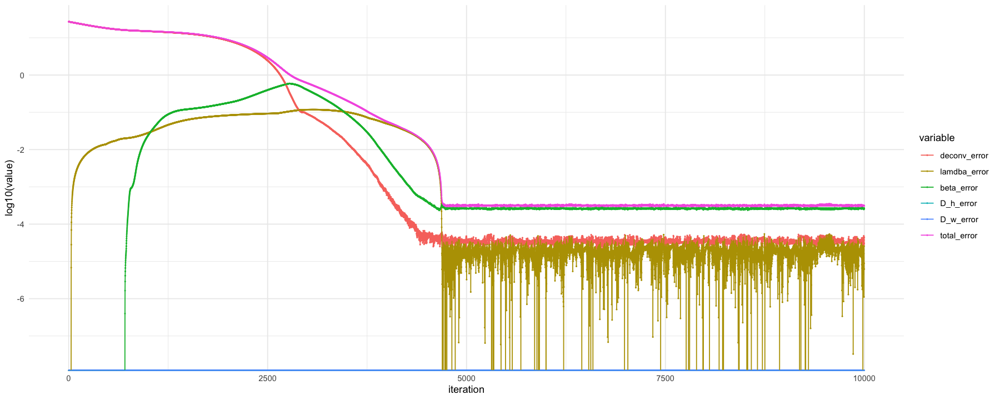

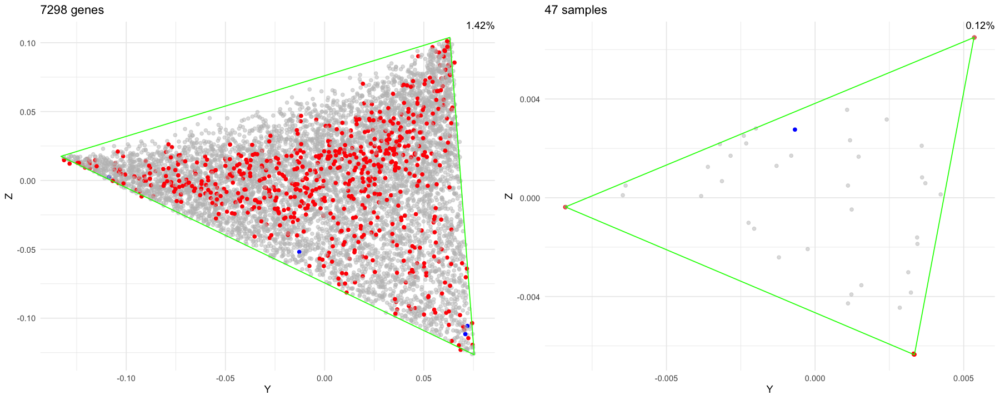

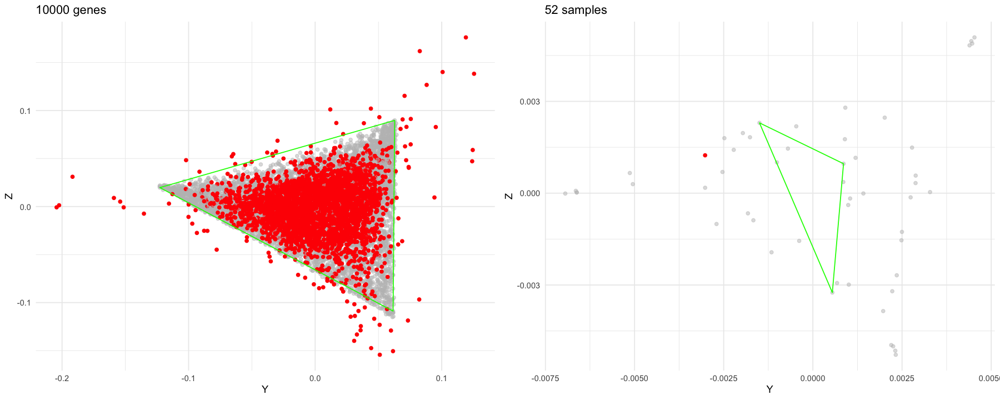

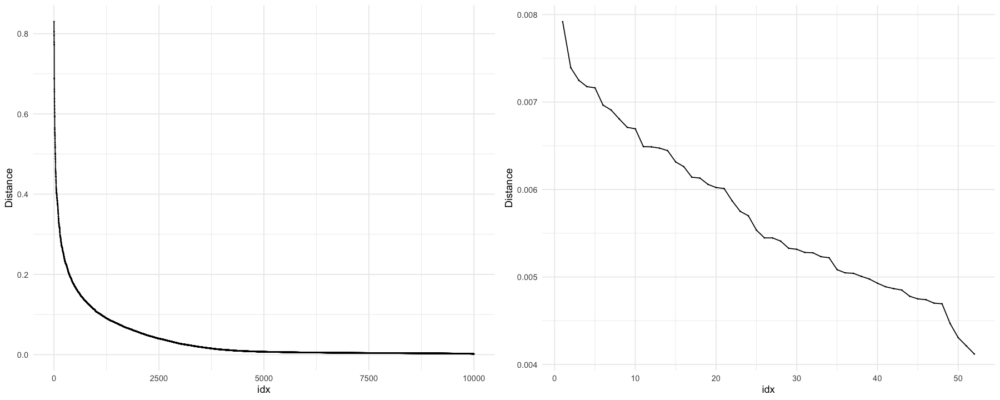

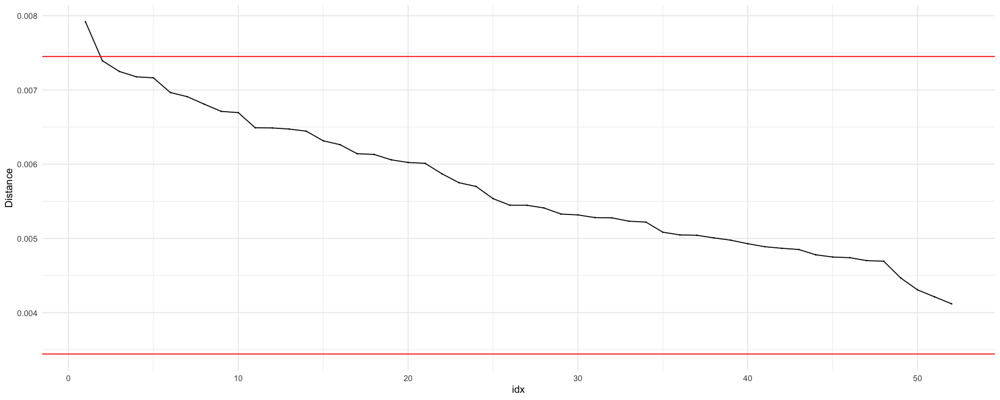

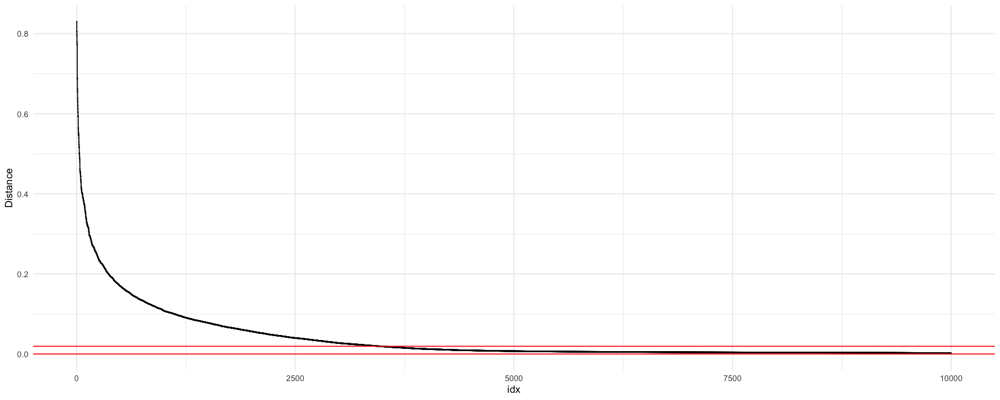

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


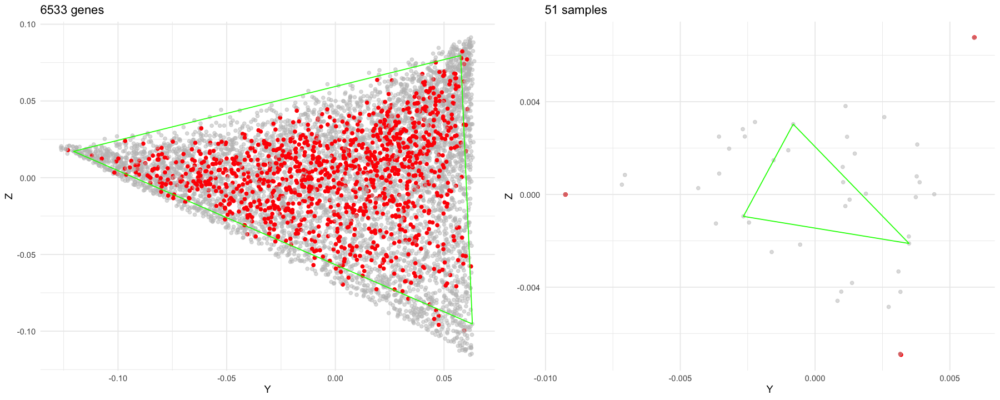

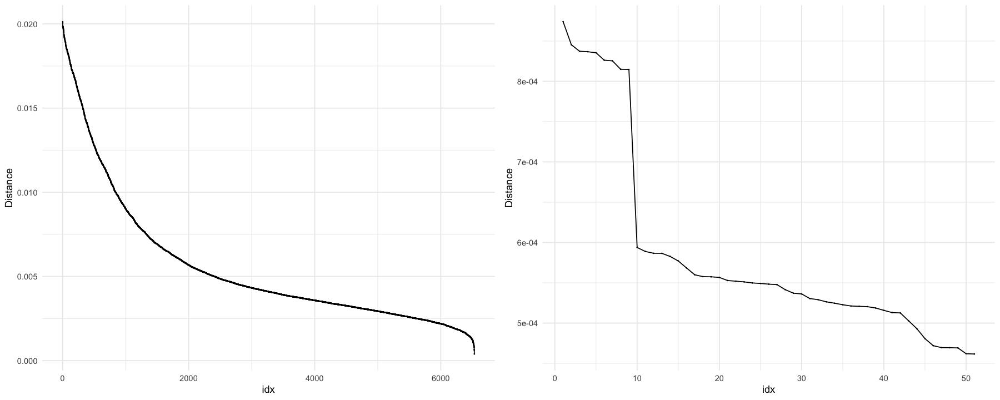

linseed2_tests/experiments/3_2_5_linseed2.rds



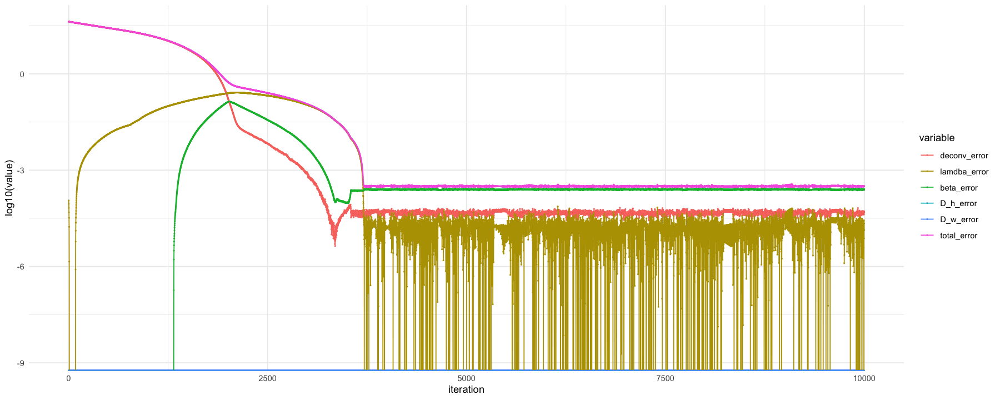

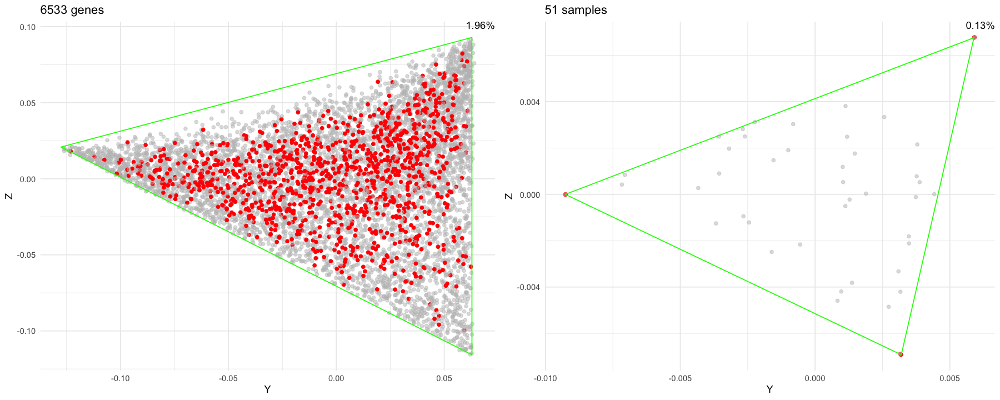

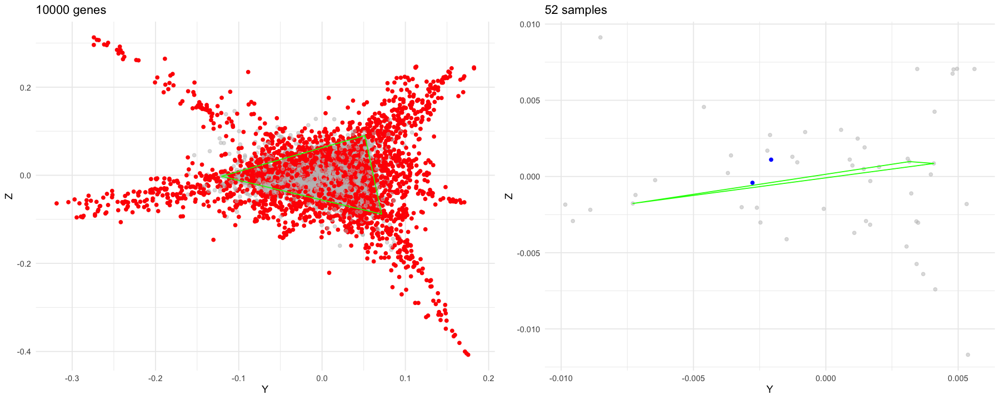

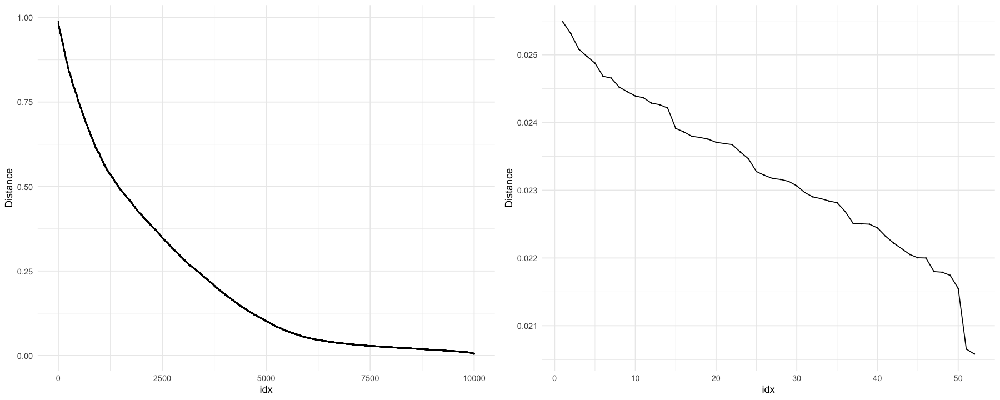

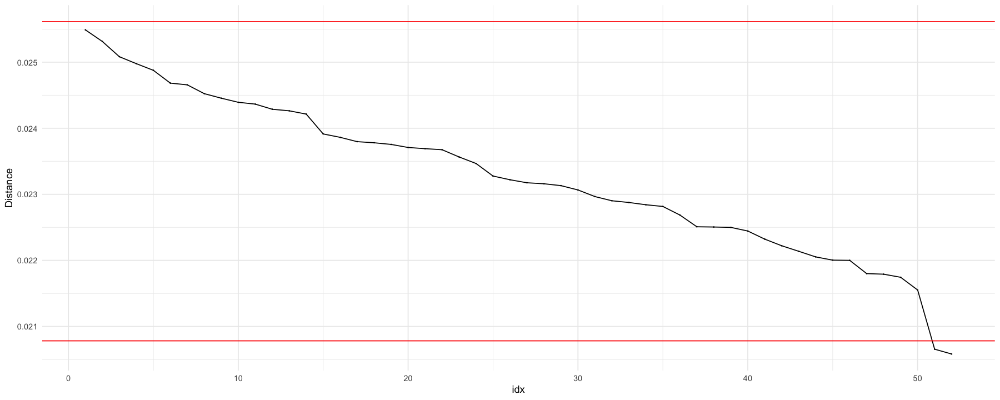

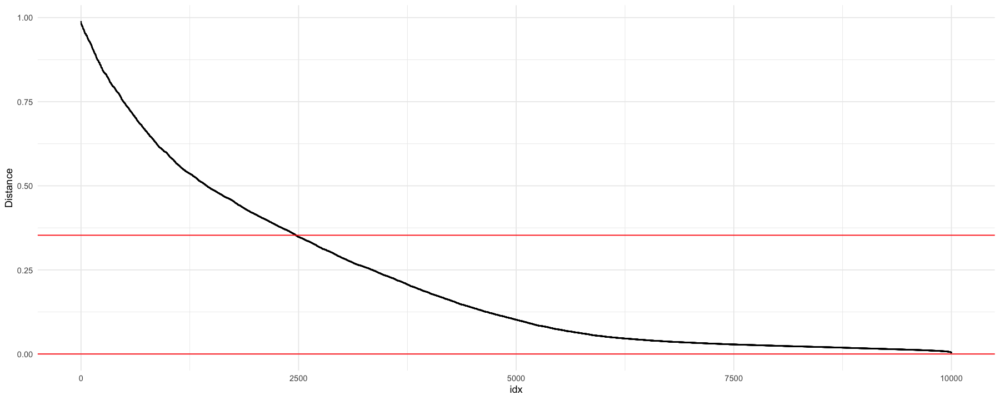

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


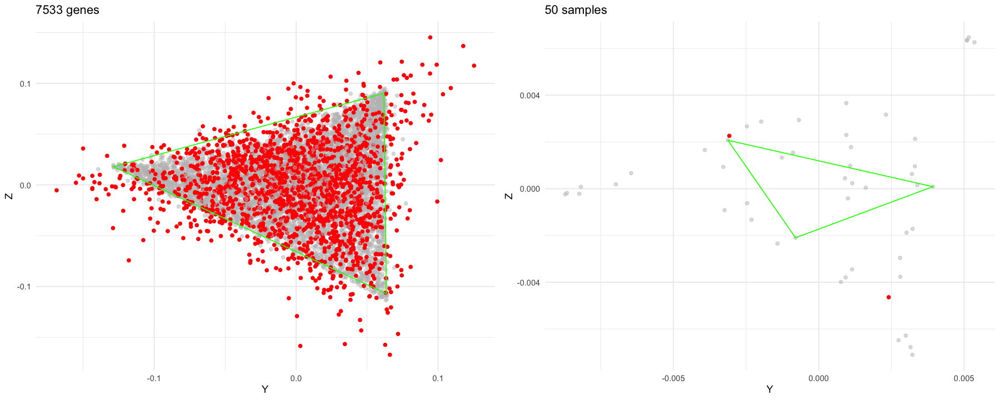

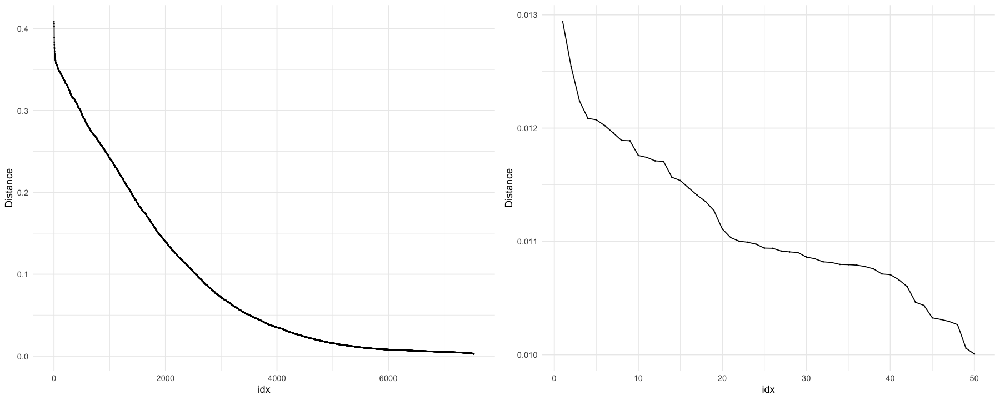

linseed2_tests/experiments/3_3_0_linseed2.rds



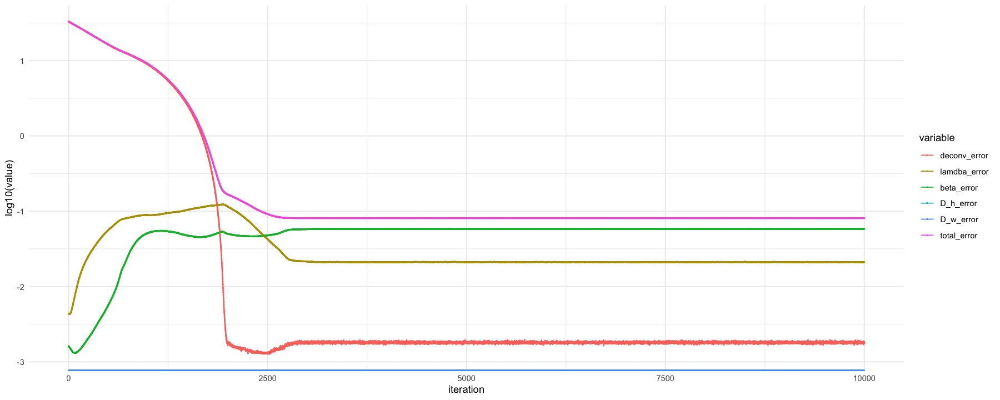

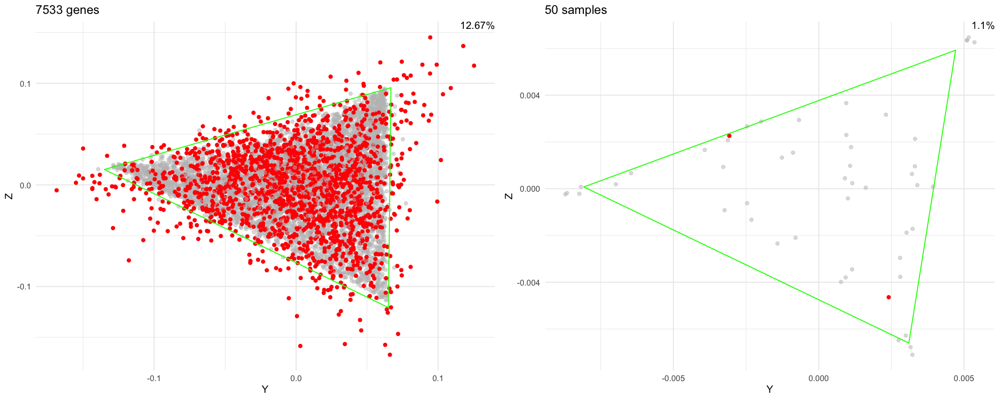

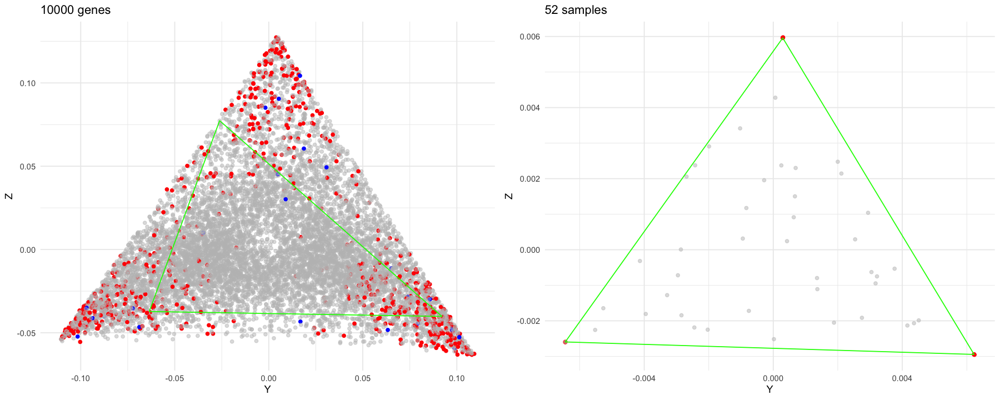

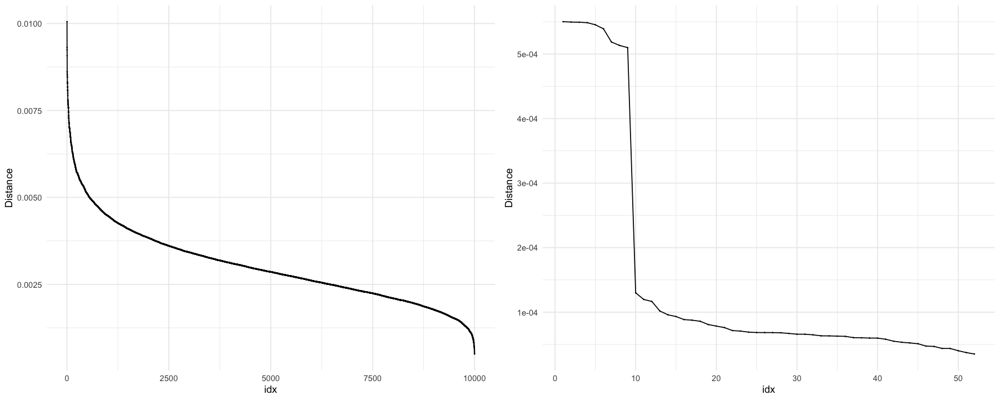

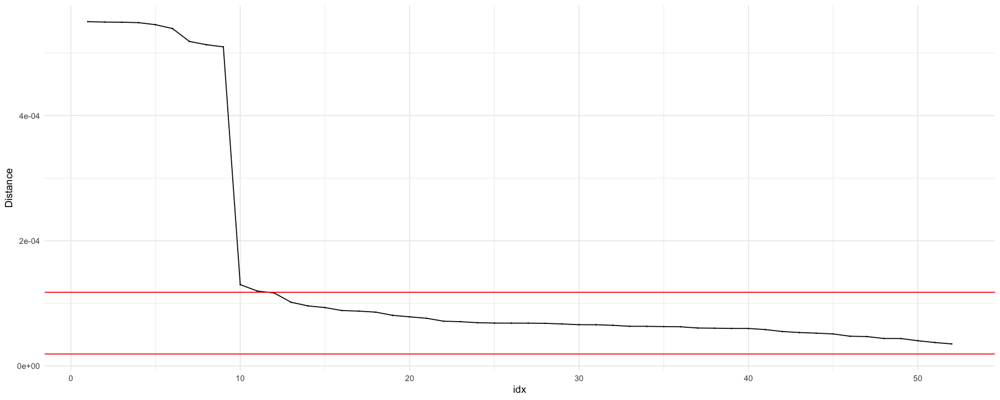

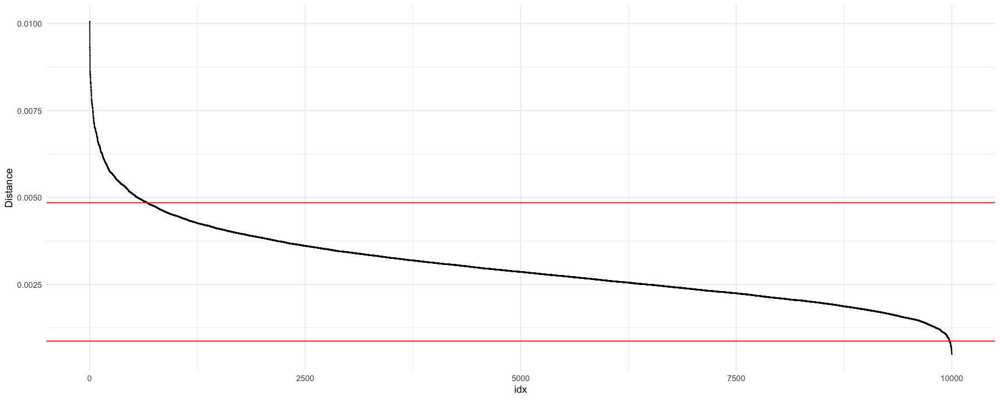

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


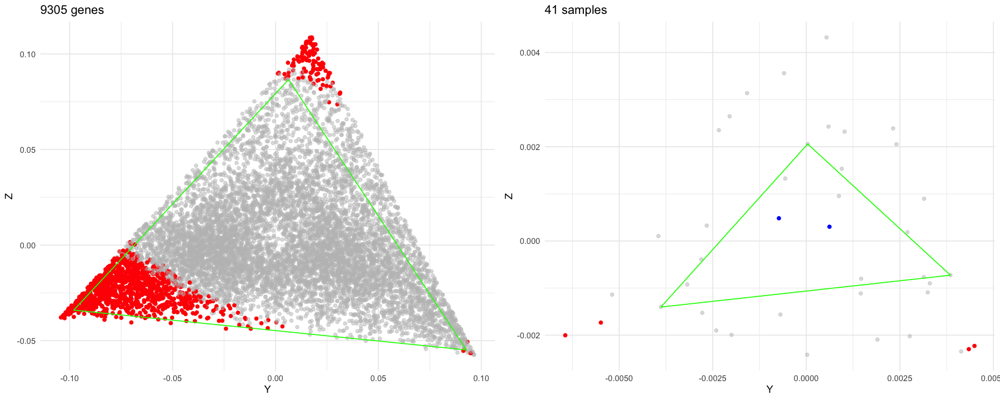

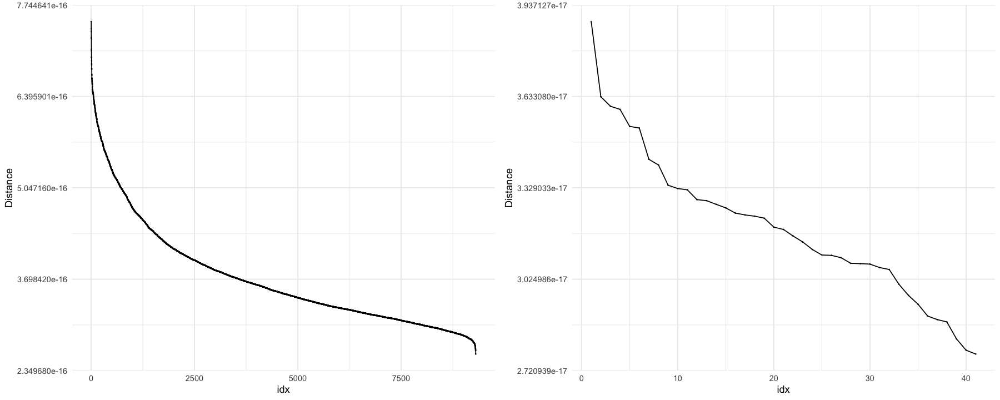

linseed2_tests/experiments/3_3_2_linseed2.rds



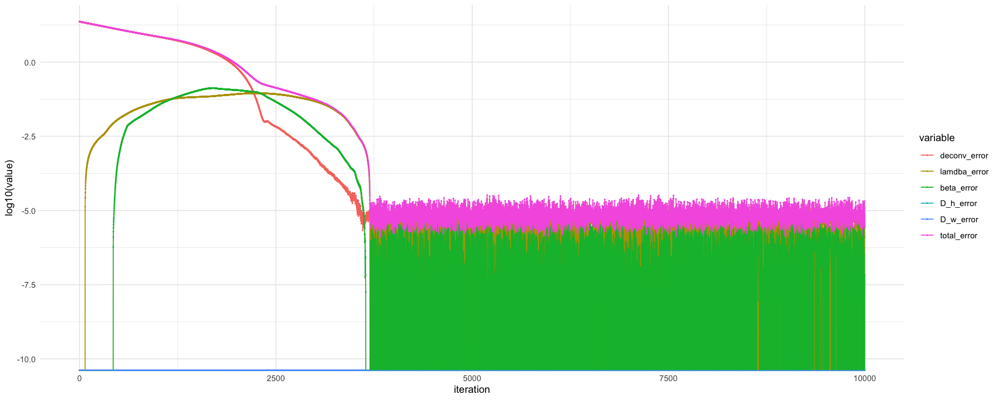

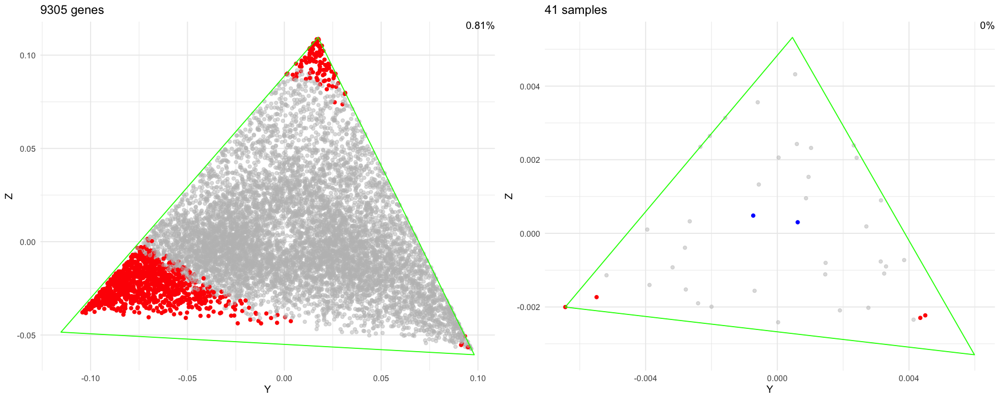

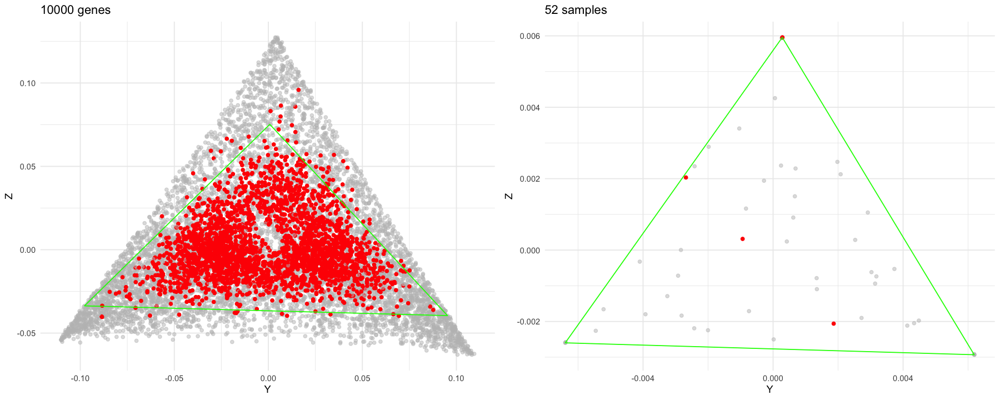

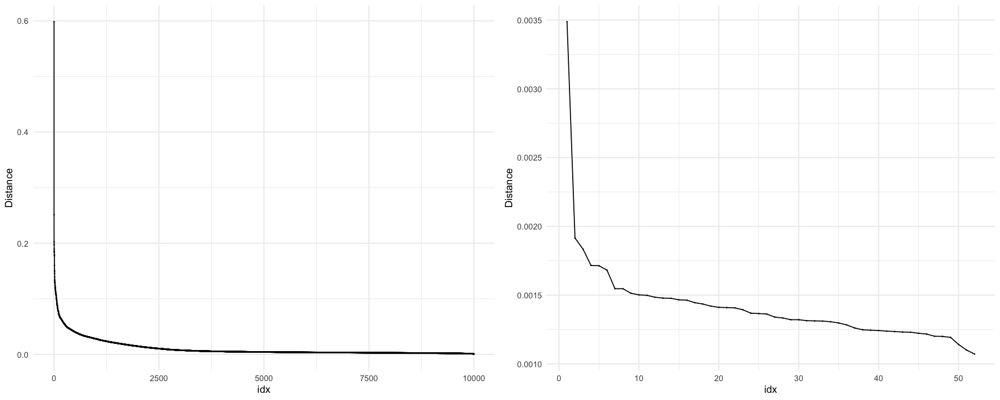

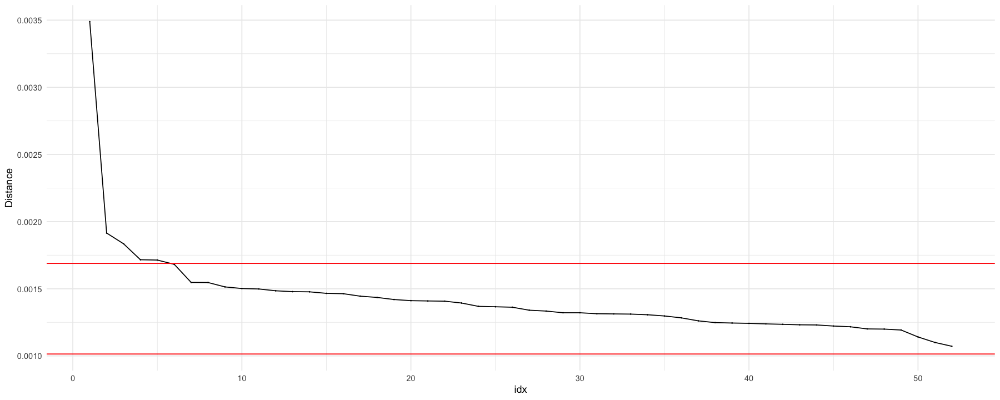

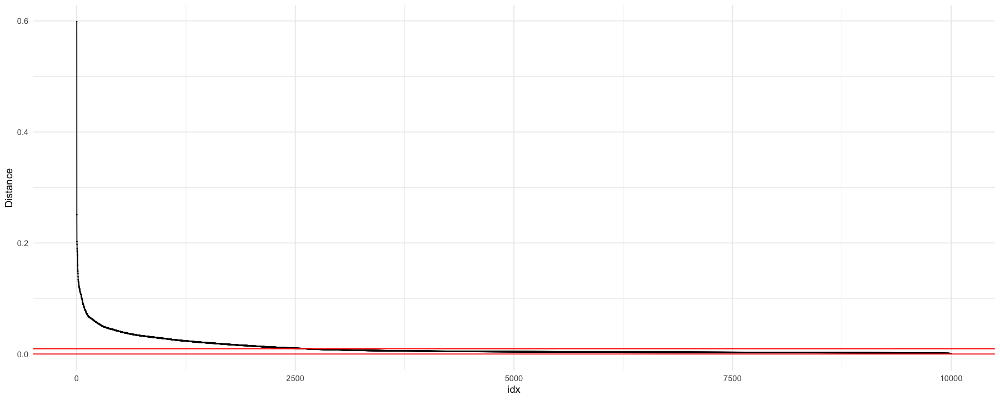

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


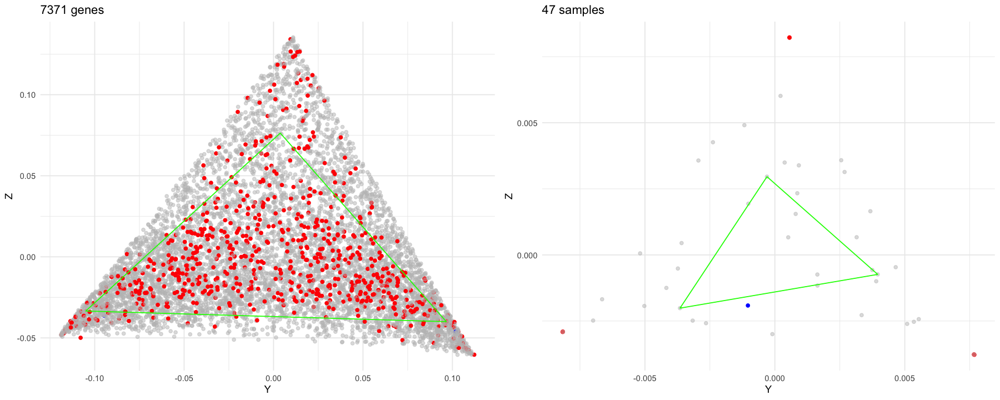

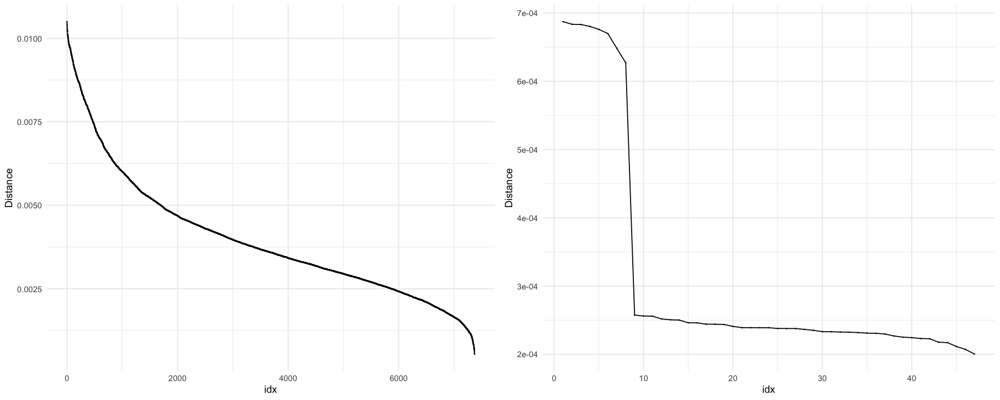

linseed2_tests/experiments/3_3_3_linseed2.rds



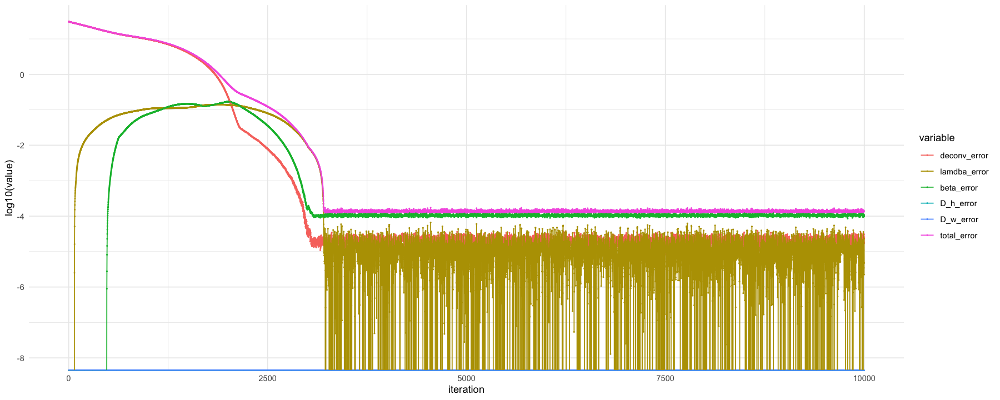

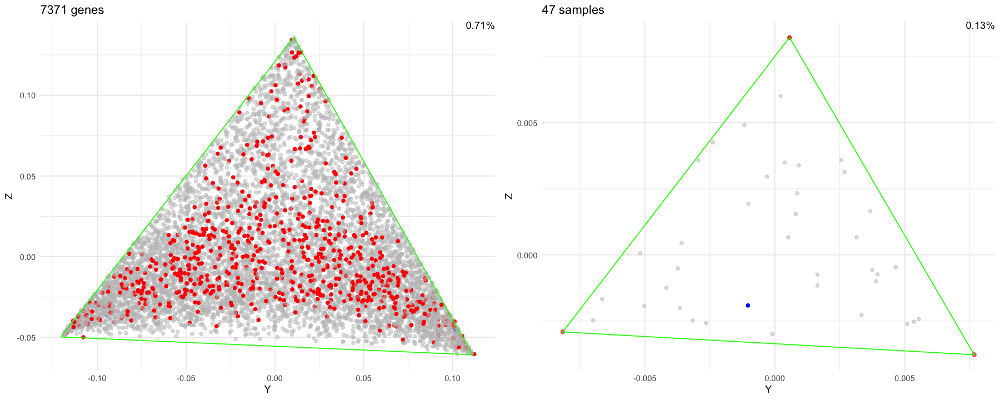

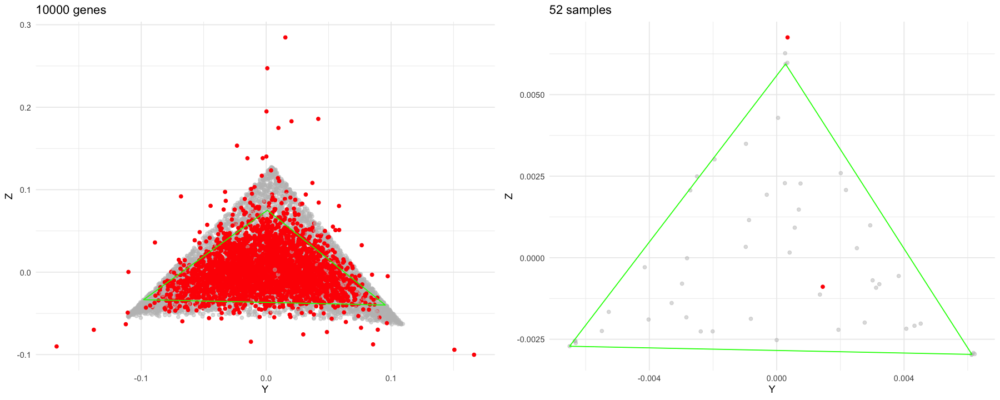

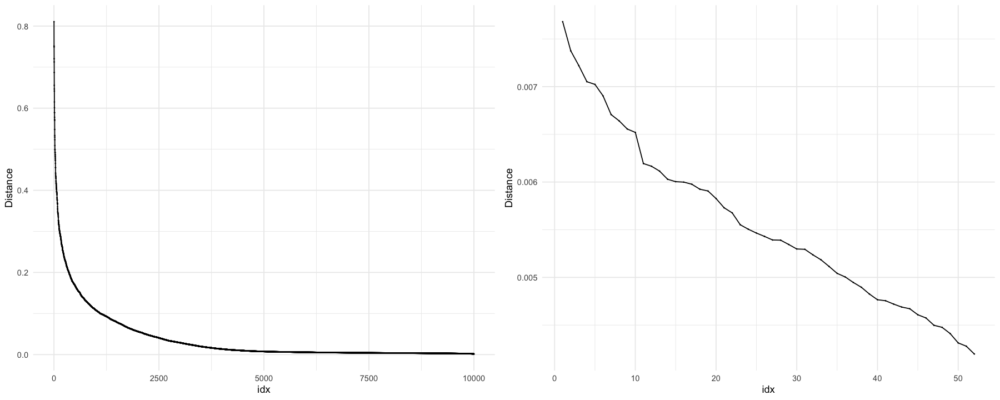

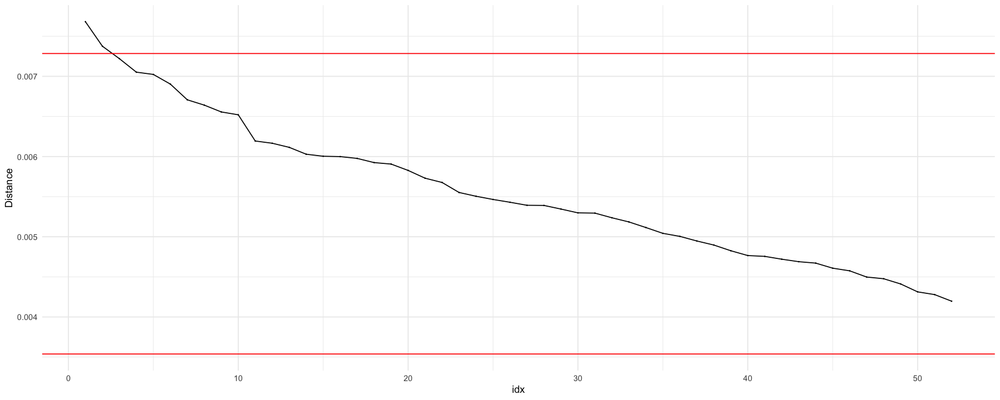

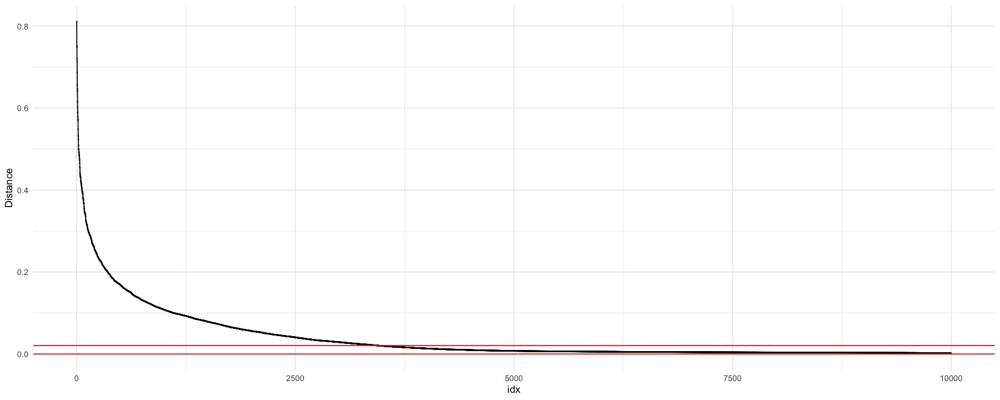

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


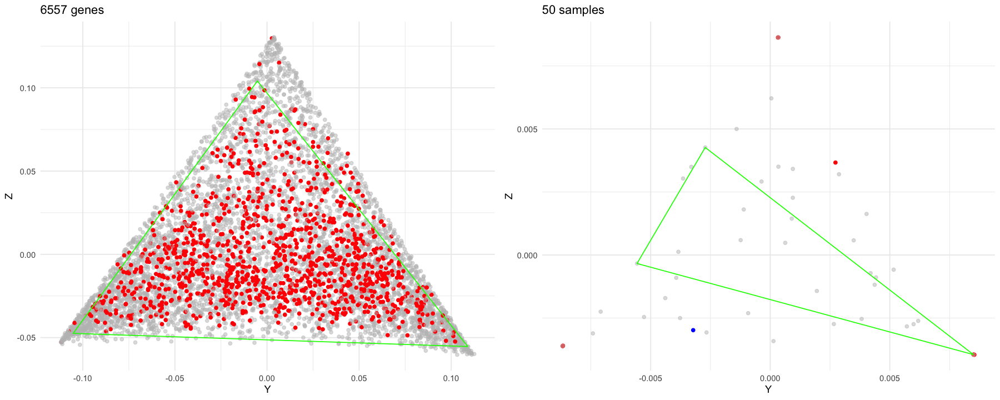

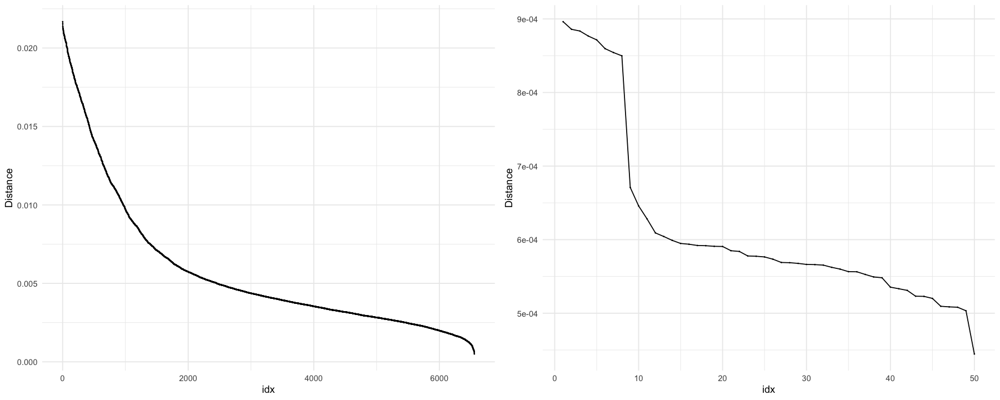

linseed2_tests/experiments/3_3_5_linseed2.rds



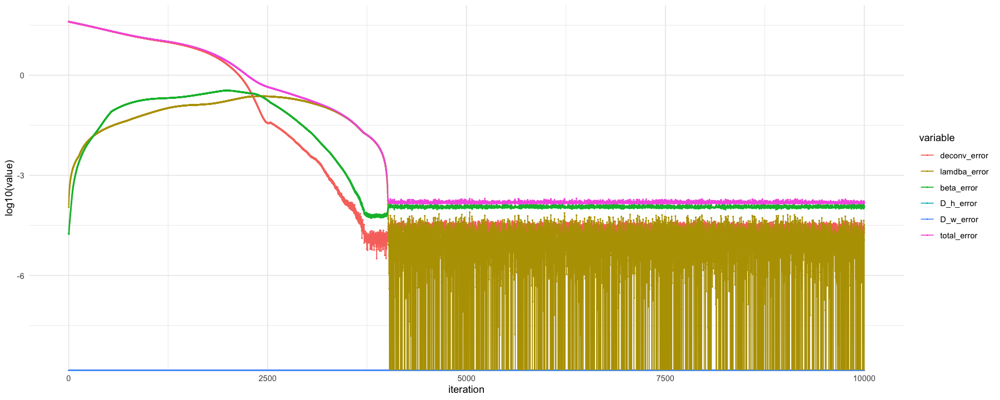

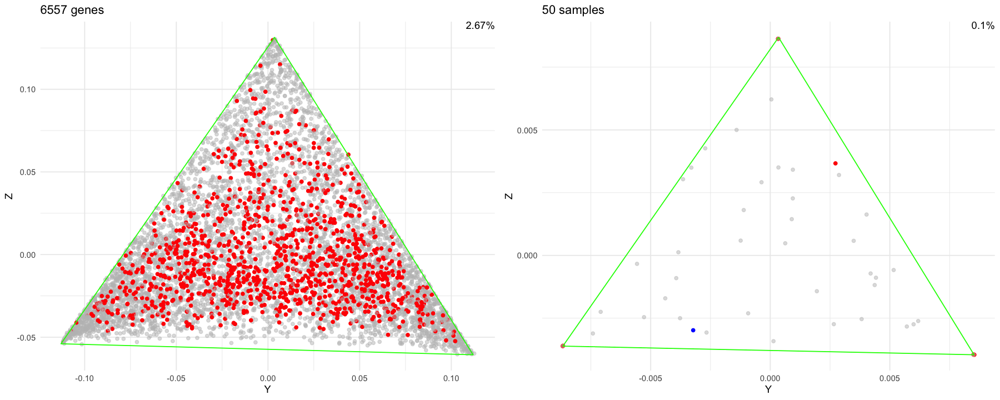

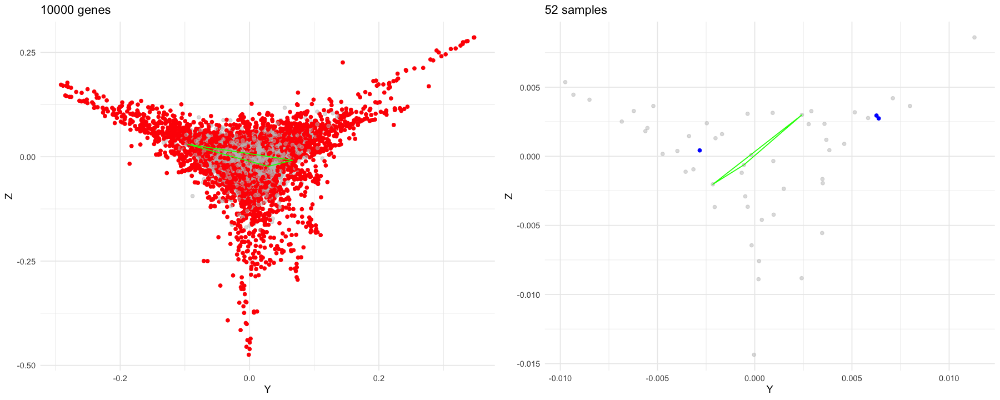

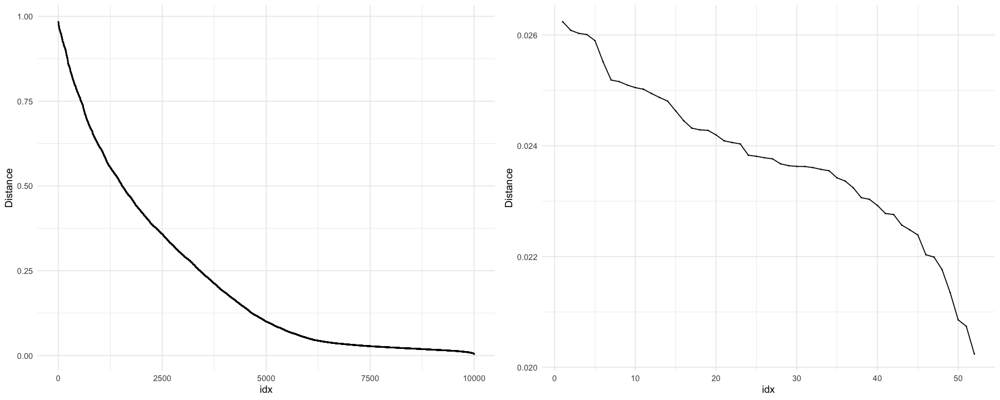

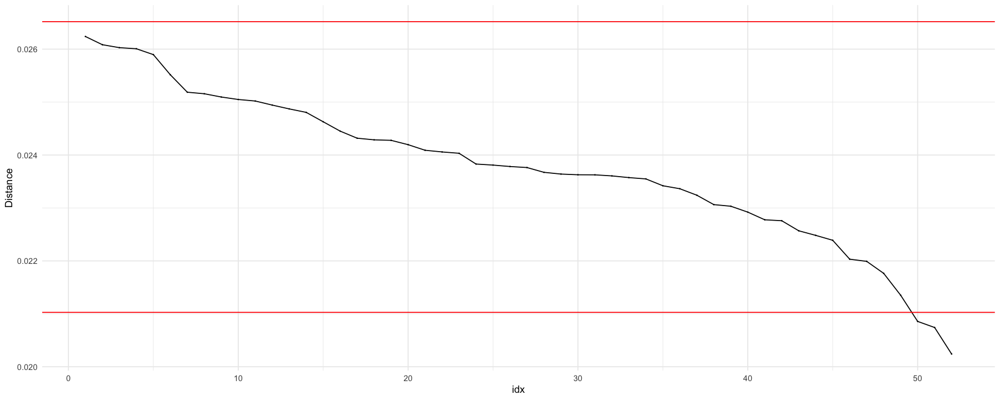

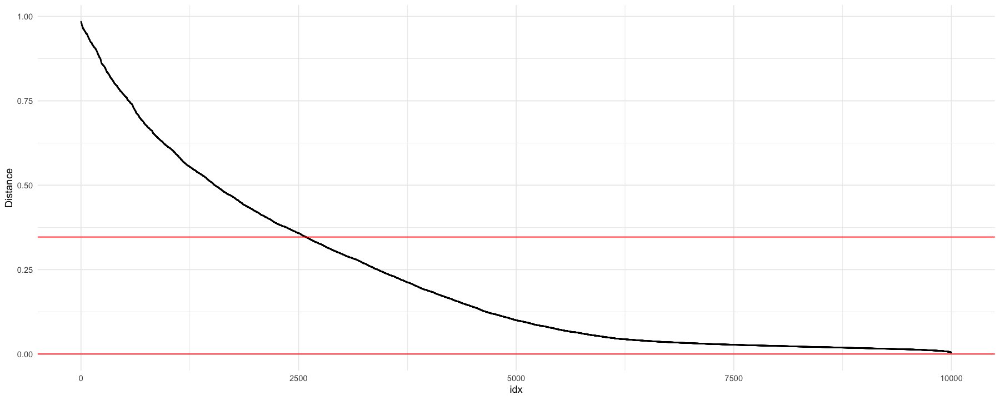

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”


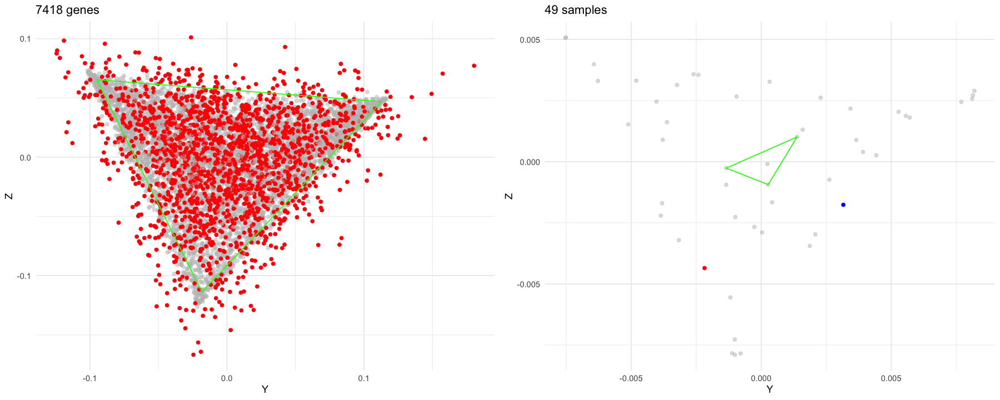

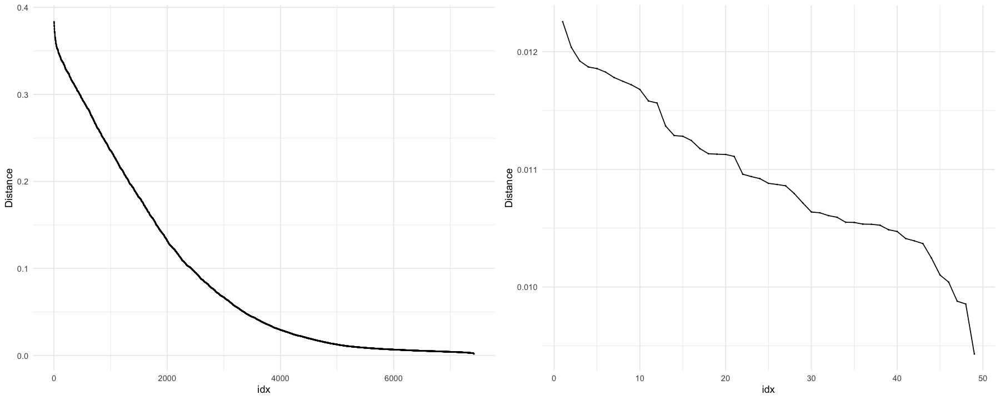

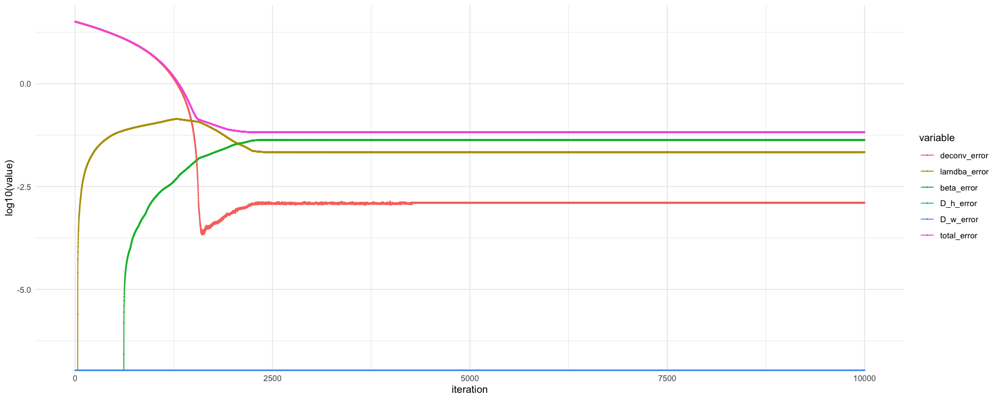

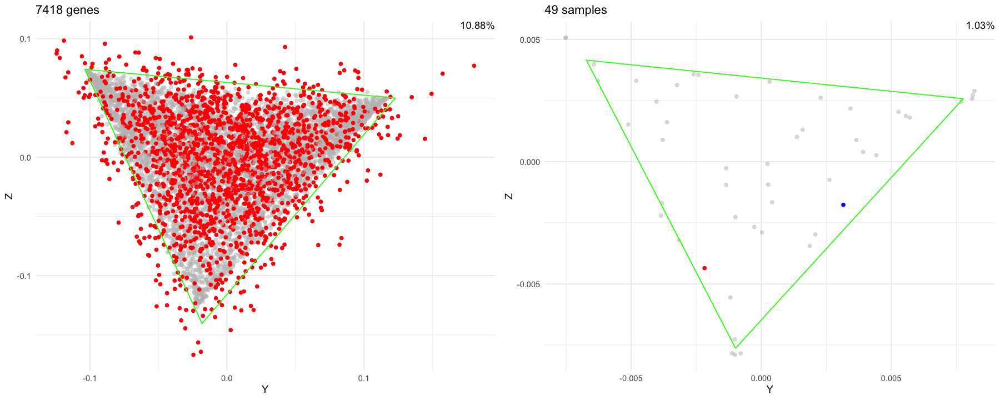

In [75]:
for (ntypes in ntypes_variants)
for(rep in reps)
for(noise in noises)
for(model_name in model_names) {
    if (!experimentExists(ntypes, rep, noise, model_name)) {
        simulation <- loadSimulation(ntypes, rep, noise)
        data <- simulation$data[, simulation$mixed_sample_names]
        message(getExperimentFilename(ntypes, rep, noise, model_name))
        fit <- fitDeconvolutionModel(simulation$data, model_name, ntypes, simulation$marker_list, TRUE)
        if (model_name == "linseed") {
            exp <- list(
                proportions = fit$proportions,
                signatures = fit$signatures
            )
        } else if (model_name == "linseed2") {
            rownames(fit$full_basis) <- rownames(fit$filtered_dataset)
            colnames(fit$full_proportions) <- colnames(fit$filtered_dataset)
            exp <- list(
                proportions = fit$full_proportions,
                signatures = fit$full_basis
            )
        } else {
            exp <- list(
                proportions = coef(fit),
                signatures = basis(fit)
            )
        }
        saveExperiment(exp, ntypes, rep, noise, model_name)
        gc()
    }
}

In [ ]:
tmp <- foreach(ntypes = ntypes_variants) %:%
        foreach(rep = reps) %:%
        foreach(noise = noises) %:%
        foreach(model_name = model_names) %dopar% {
            source("R/deconvolution.R")
            if (!experimentExists(ntypes, rep, noise, model_name)) {
                simulation <- loadSimulation(ntypes, rep, noise)
                data <- simulation$data[, simulation$mixed_sample_names]
                fit <- fitDeconvolutionModel(simulation$data, model_name, ntypes, simulation$marker_list, TRUE)
                if (model_name == "linseed") {
                    exp <- list(
                        proportions = fit$proportions,
                        signatures = fit$signatures
                    )
                } else if (model_name == "linseed2") {
                    rownames(fit$full_basis) <- fit$top_genes
                    exp <- list(
                        proportions = fit$full_proportions,
                        signatures = fit$full_basis
                    )
                } else {
                    exp <- list(
                        proportions = coef(fit),
                        signatures = basis(fit)
                    )
                }
                saveExperiment(exp, ntypes, rep, noise, model_name)
                gc()
            }
            NULL
        }

# Calculate metrics

In [77]:
loadExperiment(ntypes = 3, rep = 1, noise = 5, model_name = "linseed2")

$proportions
       sample_1  sample_2  sample_3  sample_4  sample_5   sample_6   sample_7
[1,] 0.83104257 0.3420272 0.6299422 0.2565581 0.4755348 0.68126506 0.69224041
[2,] 0.10570394 0.1261978 0.2311128 0.4379188 0.2960755 0.25249140 0.29351321
[3,] 0.06325348 0.5317750 0.1389451 0.3055230 0.2283897 0.06624354 0.01424638
      sample_8   sample_9  sample_10  sample_11 sample_12 sample_13 sample_14
[1,] 0.4104300 0.53268921 0.23621285 0.51484076 0.1268352 0.1463580 0.3657812
[2,] 0.2891219 0.05673179 0.01845892 0.03946052 0.1107685 0.4173881 0.3620586
[3,] 0.3004481 0.41057900 0.74532823 0.44569872 0.7623963 0.4362539 0.2721602
      sample_15 sample_16  sample_17 sample_18 sample_19 sample_20 sample_21
[1,] 0.88255185 0.4681054 0.02213019 0.2562324 0.1873857 0.4350225 0.1423791
[2,] 0.06400255 0.4254903 0.97289953 0.2346581 0.2903765 0.4610012 0.5842885
[3,] 0.05344560 0.1064044 0.00497029 0.5091095 0.5222378 0.1039763 0.2733324
     sample_22  sample_23    sample_24 sample_25  sample_26  sample_27
[1,] 0.3177800 0.04759873 5.286038e-01 0.3861032 0.93538024 0.02917657
[2,] 0.3239166 0.07575550 3.354648e-06 0.2345348 0.05281348 0.48267430
[3,] 0.3583034 0.87664577 4.713928e-01 0.3793620 0.01180627 0.48814912
     sample_28 sample_29 sample_30 sample_31  sample_32 sample_33 sample_34
[1,] 0.2487657 0.2722732 0.2555956 0.3370448 0.13283289 0.0000000 0.1730413
[2,] 0.3163166 0.3574249 0.4438432 0.3421085 0.05582711 0.1052277 0.3297918
[3,] 0.4349177 0.3703018 0.3005612 0.3208467 0.81134000 0.8947723 0.4971669
      sample_35 sample_36  sample_37  sample_38 sample_39 sample_40
[1,] 0.52902298 0.4747787 0.70044902 0.13756746 0.1413158 0.3945758
[2,] 0.08871317 0.3639750 0.07768976 0.80260702 0.3698305 0.1979756
[3,] 0.38226385 0.1612463 0.22186122 0.05982553 0.4888537 0.4074486
     pure_sample_1 pure_sample_2 pure_sample_3 pure_sample_4 pure_sample_5
[1,]             0   0.029332281             0             0             0
[2,]             1   0.965662468             1             0             0
[3,]             0   0.005005251             0             1             1
     pure_sample_6 pure_sample_7 pure_sample_8 pure_sample_9 basis_sample_1
[1,]  8.244614e-05  0.9998798802     0.9878482    0.98626788     0.00000000
[2,]  0.000000e+00  0.0001201198     0.0121518    0.00000000     0.98974306
[3,]  9.999176e-01  0.0000000000     0.0000000    0.01373212     0.01025694
     basis_sample_2 basis_sample_3
[1,]     0.00000000              1
[2,]     0.03695299              0
[3,]     0.96304701              0

$signatures
                   [,1]         [,2]         [,3]
gene_4076  9.761638e-01 7.434143e-03 0.0164020710
gene_355   3.234102e-02 2.049116e-02 0.9471678146
gene_4037  1.289299e-01 7.988237e-01 0.0722464215
gene_370   2.450303e-02 1.592950e-01 0.8162019998
gene_723   8.203481e-01 1.652969e-01 0.0143549900
gene_847   9.018391e-01 9.051537e-02 0.0076455646
gene_3058  4.395222e-02 8.316213e-01 0.1244264521
gene_6443  6.658723e-03 1.663042e-02 0.9767108556
gene_10909 1.268453e-02 1.329327e-01 0.8543827863
gene_8054  2.485442e-01 4.475854e-01 0.3038703943
gene_8215  1.311408e-02 2.271881e-02 0.9641671160
gene_6004  8.390689e-01 1.161516e-01 0.0447795447
gene_7564  3.221124e-02 9.585771e-01 0.0092116794
gene_9058  7.432135e-01 2.449363e-01 0.0118501570
gene_7920  3.155909e-01 6.363054e-01 0.0481036895
gene_8521  8.425891e-01 7.125959e-02 0.0861512878
gene_4165  2.002216e-02 9.753275e-01 0.0046503482
gene_2760  8.638709e-01 5.323468e-02 0.0828944349
gene_4306  1.466467e-02 3.503821e-02 0.9502971196
gene_8863  4.793036e-02 1.841260e-01 0.7679436840
gene_8480  1.080482e-01 5.842766e-01 0.3076751913
gene_8015  7.274929e-01 2.660630e-01 0.0064440536
gene_816   6.482011e-01 3.432126e-01 0.0085862750
gene_7882  1.394327e-02 2.895571e-02 0.9571010202
gene_5265  5.164252e-02 2.450863e-01 0.7032712006
gene_8040  8.396260e-01 5.906802e-02 0.1013059786
gene_6489  4.933334e-01 4.175480e-01 0.0891186183
gene_7267  9.121504e-01 5.892726e-02 0

In [69]:
experiment_table <- data.table::CJ(ntypes_variants, reps, noises, model_names)
colnames(experiment_table) <- c("ntypes", "rep", "noise", "model")
head(experiment_table)

ntypes,rep,noise,model
<dbl>,<dbl>,<dbl>,<chr>
3,1,0,dsa
3,1,0,linseed2
3,1,2,dsa
3,1,2,linseed2
3,1,3,dsa
3,1,3,linseed2


In [81]:
for (i in 1:nrow(experiment_table)) {    
    exp <- loadExperiment(
        experiment_table[i, "ntypes"],
        experiment_table[i, "rep"],
        experiment_table[i, "noise"],
        experiment_table[i, "model"]
    )
    sim <- loadSimulation(
        experiment_table[i, "ntypes"],
        experiment_table[i, "rep"],
        experiment_table[i, "noise"]
    )
    props <- getExperimentPredTrueProps(exp, sim)
    
    experiment_table[i, "proportions_r2"] <- r2(props$true, props$pred)
    experiment_table[i, "proportions_rmse"] <- rmse(props$true, props$pred)
    experiment_table[i, "proportions_nrmse"] <- experiment_table[i, "proportions_rmse"] / IQR(props$true)
}

In [82]:
for (i in 1:nrow(experiment_table)) {    
    exp <- loadExperiment(
        experiment_table[i, "ntypes"],
        experiment_table[i, "rep"],
        experiment_table[i, "noise"],
        experiment_table[i, "model"]
    )
    sim <- loadSimulation(
        experiment_table[i, "ntypes"],
        experiment_table[i, "rep"],
        experiment_table[i, "noise"]
    )

    basis <- getExperimentPredTrueBasis(exp, sim)
    
    experiment_table[i, "basis_r2"] <- r2(basis$true, basis$pred)
    experiment_table[i, "basis_rmse"] <- rmse(basis$true, basis$pred)
    experiment_table[i, "basis_nrmse"] <- experiment_table[i, "basis_rmse"] / IQR(basis$true)
}

In [83]:
head(experiment_table)

ntypes,rep,noise,model,proportions_r2,proportions_rmse,proportions_nrmse,basis_r2,basis_rmse,basis_nrmse
<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3,1,0,dsa,0.9900805,0.03912540,0.09721563,9.958520e-01,7313.357,5.619604
3,1,0,linseed2,0.9961029,0.01552698,0.04709714,5.044316e-06,81924.881,49.187816
3,1,2,dsa,0.9900817,0.03912758,0.09722103,9.958516e-01,7313.922,5.620038
3,1,2,linseed2,0.9950578,0.02065600,0.05532685,8.515277e-05,113794.028,38.116039
3,1,3,dsa,0.9900829,0.03913845,0.09724805,9.958501e-01,7316.247,5.621824
3,1,3,linseed2,0.9960960,0.01922645,0.04719623,3.842228e-03,120186.264,34.019058


In [84]:
saveExperimentTable(experiment_table)

In [85]:
pure_data_table <- data.table::CJ(ntypes_variants, reps, noises, "pure_data")
colnames(pure_data_table) <- c("ntypes", "rep", "noise", "model")
for (i in 1:nrow(pure_data_table)) {
    sim <- loadSimulation(
        pure_data_table[i, "ntypes"],
        pure_data_table[i, "rep"],
        pure_data_table[i, "noise"]
    )
    pure_data_table[i, "basis_r2"] <- r2(sim$data[, sim$basis_sample_names], sim$basis)
    pure_data_table[i, "basis_rmse"] <- rmse(sim$data[, sim$basis_sample_names], sim$basis)
    pure_data_table[i, "basis_nrmse"] <- pure_data_table[i, "basis_rmse"] / mean(sim$data[, sim$basis_sample_names])
}
head(pure_data_table)

ntypes,rep,noise,model,basis_r2,basis_rmse,basis_nrmse
<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>
3,1,0,pure_data,1.0000000,1.000000,1.431054e-04
3,1,2,pure_data,1.0000000,6.690715,9.572567e-04
3,1,3,pure_data,0.9999996,60.115125,8.593164e-03
3,1,5,pure_data,0.9769774,14046.515756,1.910608e+00
3,2,0,pure_data,1.0000000,1.000000,7.381471e-05
3,2,2,pure_data,1.0000000,6.731339,4.968126e-04


# Plots

In [86]:
experiment_table <- loadExperimentTable()

In [87]:
head(experiment_table)

ntypes,rep,noise,model,proportions_r2,proportions_rmse,proportions_nrmse,basis_r2,basis_rmse,basis_nrmse
<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3,1,0,dsa,0.9900805,0.03912540,0.09721563,9.958520e-01,7313.357,5.619604
3,1,0,linseed2,0.9961029,0.01552698,0.04709714,5.044316e-06,81924.881,49.187816
3,1,2,dsa,0.9900817,0.03912758,0.09722103,9.958516e-01,7313.922,5.620038
3,1,2,linseed2,0.9950578,0.02065600,0.05532685,8.515277e-05,113794.028,38.116039
3,1,3,dsa,0.9900829,0.03913845,0.09724805,9.958501e-01,7316.247,5.621824
3,1,3,linseed2,0.9960960,0.01922645,0.04719623,3.842228e-03,120186.264,34.019058


## Plotting functions

In [88]:
validatePlottingArgs <- function(arr_type, metric_name, on, fixed, comparing) {
    comparing_options <- c("model", "noise", "ntypes")
    stopifnot(metric_name %in% c("r2", "rmse", "nrmse"))
    stopifnot(arr_type %in% c("basis", "proportions"))
    stopifnot(on %in% comparing_options)
    stopifnot(fixed %in% comparing_options)
    stopifnot(comparing %in% comparing_options)
    stopifnot((on != fixed) && (on != comparing) && (fixed != comparing))
    TRUE
}

In [89]:
getMetricRepr <- function(metric_name) {
    if (metric_name == "r2") {
        metric_repr <- "R^2"
    } else if (metric_name == "rmse") {
        metric_repr <- "RMSE"
    } else {
        metric_repr <- "NRMSE"
    }
    metric_repr
}

In [90]:
comparing_options_reprs <- list(
    "model" = "Model",
    "noise" = "Noise deviation",
    "ntypes" = "Cell types number"
)

In [91]:
plotPureDataMetric <- function(on) {
    stopifnot(on %in% c("noise", "ntypes"))
    reprs <- comparing_options_reprs
    data <- as.data.frame(
        melt(
            pure_data_table,
            id.vars=c("ntypes", "model", "noise", "rep"),
            variable.name = "metric_name",
            value.name = "metric_value"
        )
    )
    if (on == "noise") {
        comparing = "ntypes"
    } else {
        comparing = "noise"
    }
    data[, comparing] <- as.factor(data[, comparing])
    
    
    ggplot(data, aes_string(on, "metric_value", col = comparing)) +
        geom_line() +
        geom_point() +
        facet_wrap(~ metric_name, scales = "free") +
        ylab("Metric value") +
        xlab(reprs[[on]]) +
        labs(colour = reprs[[comparing]]) +
        ggtitle(glue::glue("Pure vs noisy expressions"))
}

In [92]:
plotMetric <- function(arr_type, metric_name, on, fixed, comparing) {
    validatePlottingArgs(arr_type, metric_name, on, fixed, comparing)
    metric_repr <- getMetricRepr(metric_name)
    reprs <- comparing_options_reprs
    
    if (arr_type == "basis") {
        data <- rbind(
            experiment_table[
                ,
                colnames(experiment_table)[!startsWith(colnames(experiment_table), "proportions")],
                with=F
            ],
            pure_data_table
        )
    } else {
        data <- experiment_table
    }
    
    col <- paste0(arr_type, "_", metric_name)
    data <- data[, .(metric_mean=mean(get(col)), metric_sd=sd(get(col))), by=list(ntypes, noise, model)]
    
    data <- as.data.frame(data)
    data[, comparing] <- as.factor(data[, comparing])
    
    ggplot(data, aes_string(on, "metric_mean", col = comparing)) +
        geom_line() +
        geom_point() +
        geom_errorbar(
            aes(
                ymin=metric_mean-metric_sd,
                ymax=metric_mean+metric_sd
            ),
            width=.1,
            position=position_dodge(0.01)
        ) +
        facet_wrap(as.formula(paste("~", fixed))) +
        ylab(glue::glue("{metric_repr}, mean across 3 replicates")) +
        xlab(reprs[[on]]) +
        labs(colour = reprs[[comparing]]) +
        ggtitle(glue::glue("Dependence of {metric_repr} (true vs predicted {arr_type}) on {tolower(reprs[[on]])} with fixed {tolower(reprs[[fixed]])}s"))

}

In [93]:
metrics <- c("r2", "rmse", "nrmse")
arr_types <- c("basis", "proportions")
plotAll <- function(dependence_on, fixed, comparing) {
    for (arr_type in arr_types) {
        for (metric_name in metrics) {
            # Workaround, bad predictions spoil plots
            if (arr_type != "basis" || metric_name == "r2") {
                show(plotMetric(
                    arr_type,
                    metric_name,
                    on = dependence_on,
                    fixed = fixed,
                    comparing = comparing
                ))
            }
        }
    }
}

## Draw plots

In [94]:
options(repr.plot.width=16, repr.plot.height=8)

### Metric on noise, fixed number of cell types (comparing models)

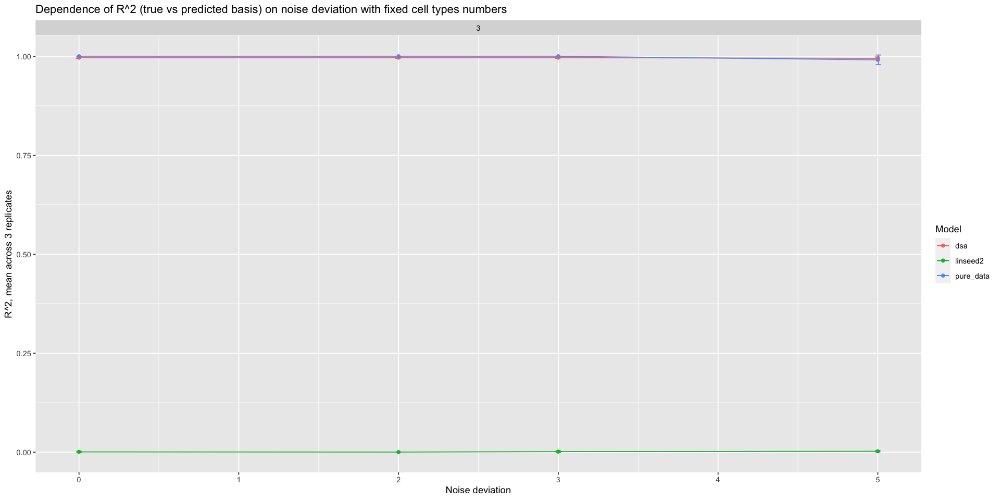

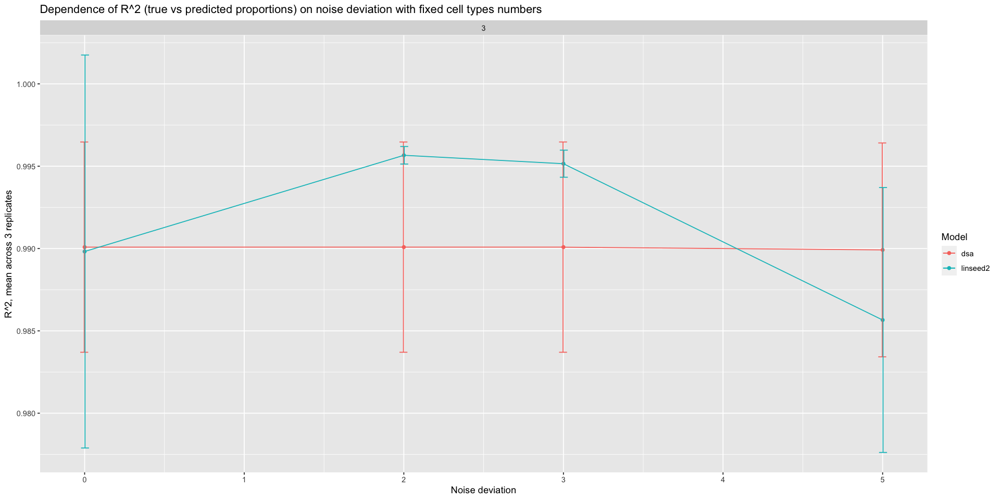

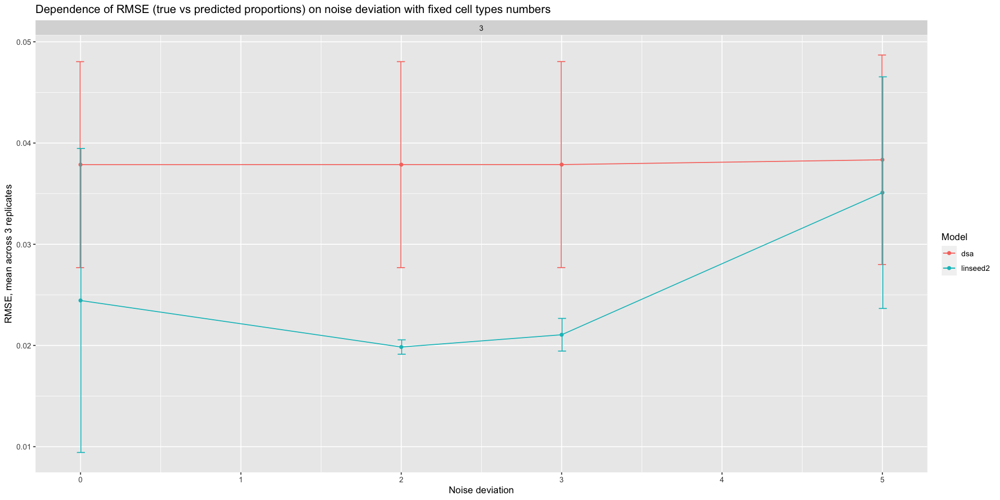

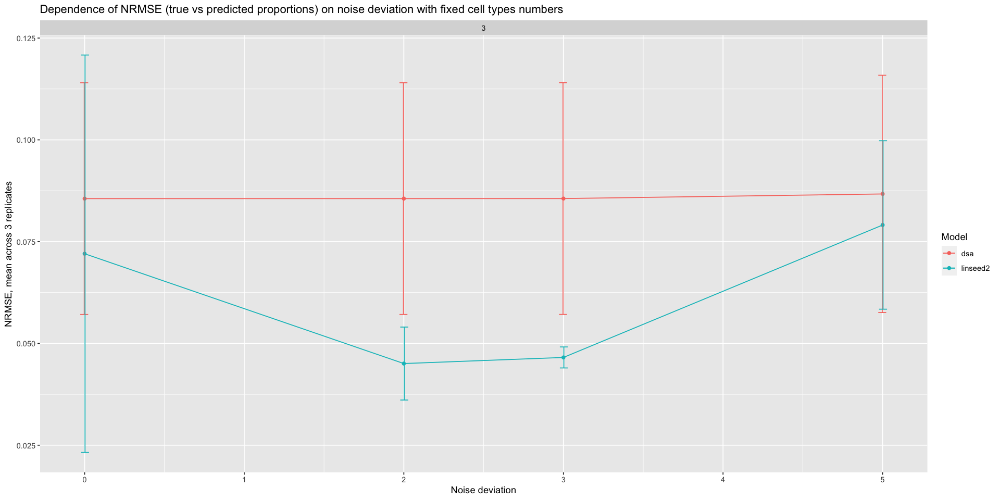

In [95]:
plotAll(dependence_on = "noise", fixed = "ntypes", comparing = "model")

### Metric on number of types, fixed noise (comparing models)

In [ ]:
plotAll(dependence_on = "ntypes", fixed = "noise", comparing = "model")

### Metric on noise, fixed model (comparing numbers of cell types)

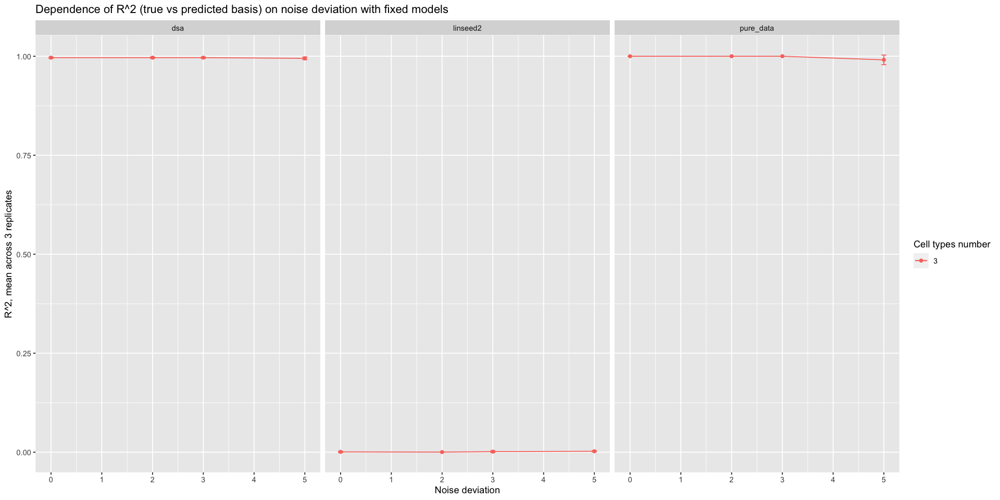

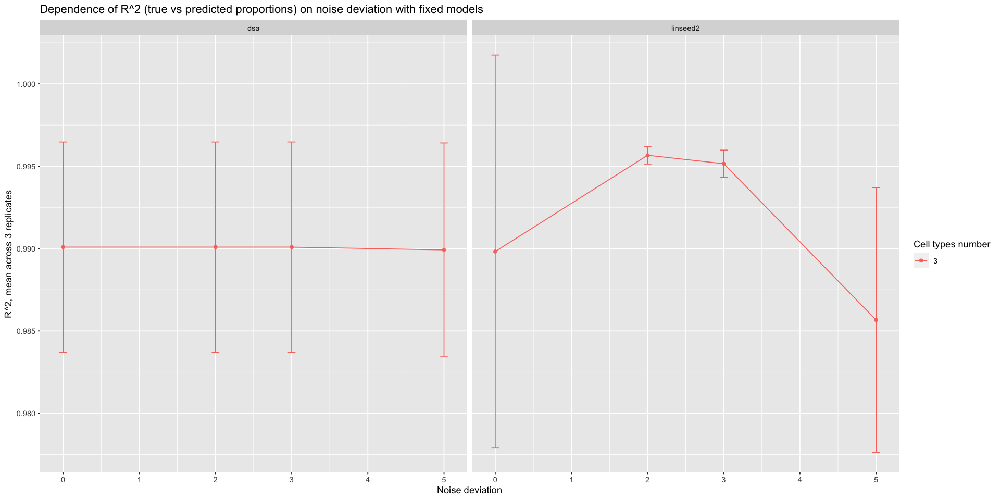

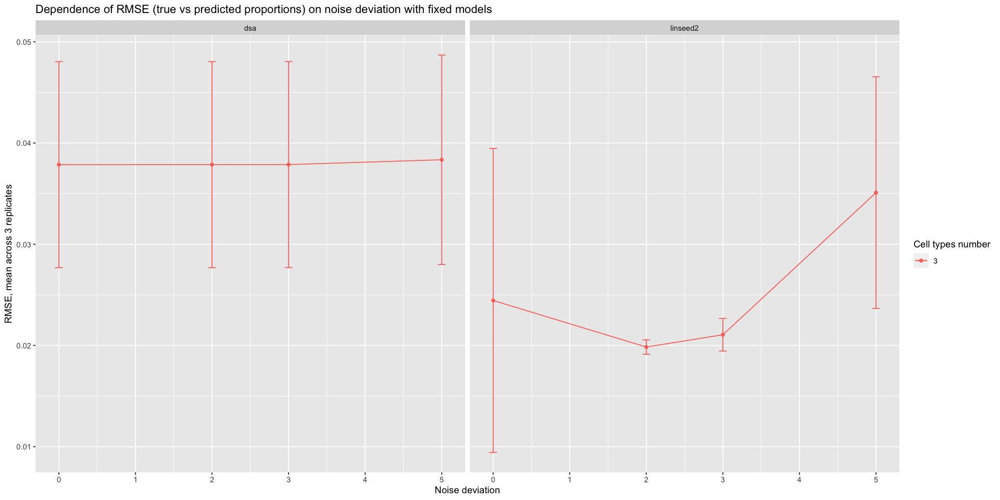

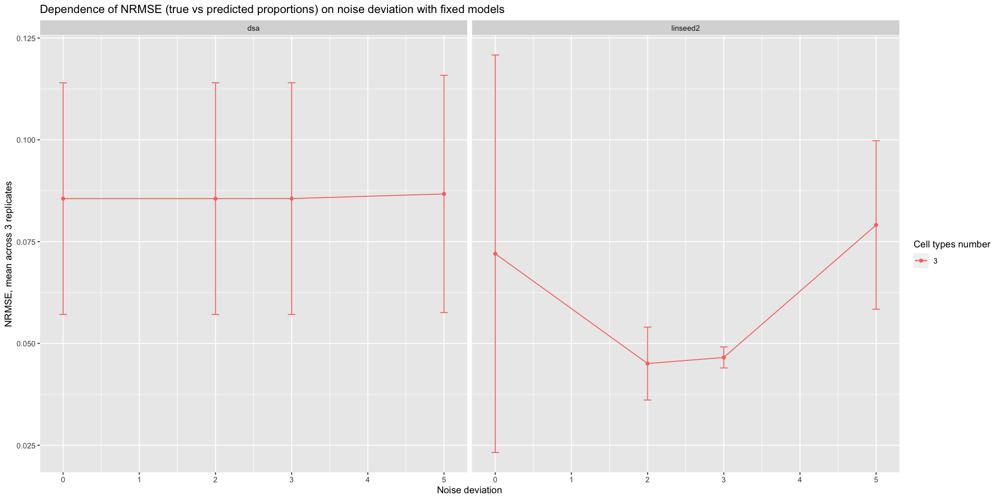

In [97]:
plotAll(dependence_on = "noise", fixed = "model", comparing = "ntypes")

### Metric on number of cell types, fixed model (comparing noise levels)

In [ ]:
plotAll(dependence_on = "ntypes", fixed = "model", comparing = "noise")

In [386]:
stopCluster(cl)